Wii-PS3間プラットフォーム競争計算機実験のための初期設定

In [21]:
using DifferentialEquations
#
sides = [:user, :cmpl]
#
TIMESTEP = 0.015625
TIMEMAX = 109
#
ComplementorsSwitchFlag=0
#
AdvertisingEndTimeA = 72
AdvertisingEndTimeB = 87
AdvertisingStartTimeA = 1
AdvertisingStartTimeB = 0
ComplementsAVelocity = Dict(:user => 0.4003, :cmpl => 0.1556)
ComplementsBVelocity = Dict(:user => 0.1381, :cmpl => 0.2204)
DepletionRateA = 0.01
DepletionRateB = 0.01
IndirectNetworkEffectsStrengthA = 0.1394  # 感度分析のためにパラメータ設定する
IndirectNetworkEffectsStrengthB = 0.253   # 感度分析のためにパラメータ設定する
InitialQualityA = 1
InitialQualityB = 1
ReferenceExpectationA = 6033.13
ReferenceExpectationB = 51.9356
ResponseTimeA = Dict(:user => 29.8852, :cmpl => 46.7199)
ResponseTimeB = Dict(:user => 4, :cmpl => 16.6598)
SalesVolumeAperUser = 2
SalesVolumeBperUser = 0.9
SubstituteValueA = Dict(:user => 1, :cmpl => 1e+07)
SubstituteValueB = Dict(:user => 45550.8, :cmpl => 3.0222e+061)
#
TotalPopulation = Dict(:user => 2.30476e+07, :cmpl => 115)
#
AdvertisingEffectivenessA = Dict(:user => 0.0001, :cmpl => 0.0153)
AdvertisingEffectivenessB = Dict(:user => 0.0039, :cmpl => 0.0119)
ContactRateA = Dict(:user => 0.9905, :cmpl => 1e-05)
ContactRateB = Dict(:user => 1e-05, :cmpl => 0.3547)
ExitRateA = Dict(:user => 0.5, :cmpl => 0.006)
ExitRateB = Dict(:user => 0.2481, :cmpl => 0.0)
ReferenceComplementVolumeA = Dict(:user => 6.68753e+07, :cmpl => 464)
ReferenceComplementVolumeB = Dict(:user => 7.40713e+07, :cmpl => 943)

Dict{Symbol, Real} with 2 entries:
  :user => 7.40713e7
  :cmpl => 943

モデルの定義

In [23]:

function systemdynamics!(dY, Y, p, t)

IndirectNetworkEffectsStrengthA, IndirectNetworkEffectsStrengthB = p
#
    # zidz function moved inside systemdynamics!

      function zidz(a, b)
          if abs(b) < 1e-6
              return 0.0
          else
              return a / b
          end
      end

 # Assign variables from Y
 AccumulatedAdoptersA = Dict(:user => Y[1], :cmpl => Y[2])
 AccumulatedAdoptersB = Dict(:user => Y[3], :cmpl => Y[4])
 ComplementsASalesVolume = Dict(:user => Y[5], :cmpl => Y[6])
 ComplementsBSalesVolume = Dict(:user => Y[7], :cmpl => Y[8])
 ExpectedQualityA = Y[9]
 ExpectedQualityB = Y[10]
 MultihomingUsers = Dict(:user => Y[11], :cmpl => Y[12])
 PlatformAAdopters = Dict(:user => Y[13], :cmpl => Y[14])
 PlatformBAdopters = Dict(:user => Y[15], :cmpl => Y[16])
 PlatformASalesVolume = Y[17]
 PlatformBSalesVolume = Y[18]
 PotentialAdopters = Dict(:user => Y[19], :cmpl => Y[20])

# Implement the equations
# Initialize dictionaries for variables that vary by side
sides = [:user, :cmpl]
flip(s) = s == :user ? :cmpl : :user

AdvertisingEffectsA = Dict(s => ifelse((t >= AdvertisingStartTimeA) && (t < AdvertisingEndTimeA), AdvertisingEffectivenessA[s]*PotentialAdopters[s], 0) for s in sides)
AdvertisingEffectsB = Dict(s => ifelse((t >= AdvertisingStartTimeB) && (t < AdvertisingEndTimeB), AdvertisingEffectivenessB[s]*PotentialAdopters[s], 0) for s in sides)

PlatformAAdopterFraction = Dict(s => PlatformAAdopters[s] / TotalPopulation[s] for s in sides)
PlatformBAdopterFraction = Dict(s => PlatformBAdopters[s] / TotalPopulation[s] for s in sides)

ComplementsASalesIncrement = Dict(s => PlatformAAdopters[s] * ComplementsAVelocity[s] for s in sides)
ComplementsBSalesIncrement = Dict(s => PlatformBAdopters[s] * ComplementsBVelocity[s] for s in sides)
ComplementValuetoPlatformA = Dict(s => ComplementsASalesVolume[s] / ReferenceComplementVolumeA[s] for s in sides)
ComplementValuetoPlatformB = Dict(s => ComplementsBSalesVolume[s] / ReferenceComplementVolumeB[s] for s in sides)

AdoptersExpectationA = PlatformAAdopters[:user] / ReferenceExpectationA
AdoptersExpectationB = PlatformBAdopters[:user] / ReferenceExpectationB
ExpectedIncrementA = AdoptersExpectationA
ExpectedIncrementB = AdoptersExpectationB
ExpectedQualityDepletionA = if t >= AdvertisingEndTimeA
    ExpectedQualityA * DepletionRateA
else
    0
end 
ExpectedQualityDepletionB = if t >= AdvertisingEndTimeB
    ExpectedQualityB * DepletionRateB
else
    0
end 

ValuetoNonPlatformAAdopters = Dict(s => ExpectedQualityA*ComplementValuetoPlatformA[flip(s)]*(PlatformAAdopterFraction[flip(s)])^IndirectNetworkEffectsStrengthA for s in sides)
ValuetoNonPlatformBAdopters = Dict(s => ExpectedQualityB*ComplementValuetoPlatformB[flip(s)]*(PlatformBAdopterFraction[flip(s)])^IndirectNetworkEffectsStrengthB for s in sides)

AdoptionFractionA = Dict(s => zidz(ValuetoNonPlatformAAdopters[s], ValuetoNonPlatformAAdopters[s] + ValuetoNonPlatformBAdopters[s] + SubstituteValueA[s]) for s in sides)
AdoptionFractionB = Dict(s => zidz(ValuetoNonPlatformBAdopters[s], ValuetoNonPlatformAAdopters[s] + ValuetoNonPlatformBAdopters[s] + SubstituteValueB[s]) for s in sides)

PlatformAValuetoPlatformAAdopters = Dict(s => ValuetoNonPlatformAAdopters[s] for s in sides)
PlatformAValuetoPlatformBAdopters = Dict(s => ValuetoNonPlatformAAdopters[s] for s in sides)
PlatformBValuetoPlatformAAdopters = Dict(s => ValuetoNonPlatformBAdopters[s] for s in sides)
PlatformBValuetoPlatformBAdopters = Dict(s => ValuetoNonPlatformBAdopters[s] for s in sides)

CombinedValuetoPlatformAAdopters = Dict(s => PlatformAValuetoPlatformAAdopters[s] + PlatformBValuetoPlatformAAdopters[s] for s in sides)
CombinedValuetoPlatformBAdopters = Dict(s => PlatformBValuetoPlatformBAdopters[s] + PlatformAValuetoPlatformBAdopters[s] for s in sides)

SwitchFractiontoA = Dict(s => zidz(PlatformAValuetoPlatformBAdopters[s], CombinedValuetoPlatformBAdopters[s] + SubstituteValueB[s]) for s in sides)
SwitchFractiontoB = Dict(s => zidz(PlatformBValuetoPlatformAAdopters[s], CombinedValuetoPlatformAAdopters[s] + SubstituteValueA[s]) for s in sides)
IndicatedSwitcherstoA = Dict(s => SwitchFractiontoA[s] * PlatformBAdopters[s] / ResponseTimeB[s] for s in sides)
IndicatedSwitcherstoB = Dict(s => SwitchFractiontoB[s] * PlatformAAdopters[s] / ResponseTimeA[s] for s in sides)

SwitchersfromAtoB = Dict(s => s==:user ? IndicatedSwitcherstoB[s] : IndicatedSwitcherstoB[s]*ComplementorsSwitchFlag for s in sides)
SwitchersfromBtoA = Dict(s => s==:user ? IndicatedSwitcherstoA[s] : IndicatedSwitcherstoA[s]*ComplementorsSwitchFlag for s in sides)
SwitcherstoA = SwitchersfromBtoA
SwitcherstoB = SwitchersfromAtoB

WordofMouthEffectsA = Dict(s => zidz(ContactRateA[s] * AdoptionFractionA[s] * PlatformAAdopters[s] * PotentialAdopters[s], TotalPopulation[s]) for s in sides)
WordofMouthEffectsB = Dict(s => zidz(ContactRateB[s] * AdoptionFractionB[s] * PlatformBAdopters[s] * PotentialAdopters[s], TotalPopulation[s]) for s in sides)

NewAdoptersA = Dict(s => min(PotentialAdopters[s]/TIMESTEP, AdvertisingEffectsA[s] + WordofMouthEffectsA[s]) for s in sides)
NewAdoptersB = Dict(s => min(PotentialAdopters[s]/TIMESTEP, AdvertisingEffectsB[s] + WordofMouthEffectsB[s]) for s in sides)

AdoptersAIncrement = Dict(s => NewAdoptersA[s] + SwitcherstoA[s] for s in sides)
AdoptersBIncrement = Dict(s => NewAdoptersB[s] + SwitcherstoB[s] for s in sides)

PlatformASalesIncrement = AdoptersAIncrement[:user]*SalesVolumeAperUser
PlatformBSalesIncrement = AdoptersBIncrement[:user]*SalesVolumeBperUser

PlatformAExit = Dict(s => ifelse(t >= AdvertisingEndTimeA, PlatformAAdopters[s]*ExitRateA[s], 0) for s in sides)
PlatformBExit = Dict(s => ifelse(t >= AdvertisingEndTimeB, PlatformBAdopters[s]*ExitRateB[s], 0) for s in sides)

MultihomingIncrement = Dict(s => SwitcherstoA[s] + SwitcherstoB[s] for s in sides)
MultihomingRatio = Dict(s => zidz(MultihomingUsers[s], (AccumulatedAdoptersA[s] + AccumulatedAdoptersB[s])) for s in sides)

TotalDiffusionRate = Dict(s => (PlatformAAdopters[s] + PlatformBAdopters[s]) / TotalPopulation[s] for s in sides)

#
# Update dY
#
dY[1] =  AdoptersAIncrement[:user]
dY[2] =  AdoptersAIncrement[:cmpl]
dY[3] =  AdoptersBIncrement[:user]
dY[4] =  AdoptersBIncrement[:cmpl]
dY[5] =  ComplementsASalesIncrement[:user]
dY[6] =  ComplementsASalesIncrement[:cmpl]
dY[7] =  ComplementsBSalesIncrement[:user]
dY[8] =  ComplementsBSalesIncrement[:cmpl]
dY[9] =  ExpectedIncrementA-ExpectedQualityDepletionA
dY[10] =  ExpectedIncrementB-ExpectedQualityDepletionB
dY[11] =  MultihomingIncrement[:user]
dY[12] =  MultihomingIncrement[:cmpl]
dY[13] = NewAdoptersA[:user]+SwitcherstoA[:user]-SwitcherstoB[:user]-PlatformAExit[:user]
dY[14] = NewAdoptersA[:cmpl]+SwitcherstoA[:cmpl]-SwitcherstoB[:cmpl]-PlatformAExit[:cmpl]
dY[15] = SwitcherstoB[:user]+NewAdoptersB[:user]-SwitcherstoA[:user]-PlatformBExit[:user]
dY[16] = SwitcherstoB[:cmpl]+NewAdoptersB[:cmpl]-SwitcherstoA[:cmpl]-PlatformBExit[:cmpl]
dY[17] =  PlatformASalesIncrement
dY[18] =  PlatformBSalesIncrement
dY[19] =  -NewAdoptersA[:user]-NewAdoptersB[:user]
dY[20] =  -NewAdoptersA[:cmpl]-NewAdoptersB[:cmpl]
#
end

systemdynamics! (generic function with 1 method)

時間積分のための初期値と時間範囲の設定
計算時間：50x50= 21 Minutes.


In [24]:
# Initial conditions
Y0 = [
    919642, 11,         # AccumulatedAdoptersA
    187836, 5,             # AccumulatedAdoptersB
    1.85346e06, 21,      # ComplementsASalesVolume
    107347, 7,             # ComplementsBSalesVolume
    InitialQualityA, InitialQualityB ,   # ExpectedQualityA, ExpectedQualityB
    0, 0,                         # MultihomingUsers
    919642, 11,        # PlatformAAdopters
    187836, 5,             # PlatformBAdopters
    919642, 187836,  # PlatformASalesVolume, PlatformBSalesVolume
    21940122,  99    # PotentialAdopters
]

# Time span
tspan = (0.0, TIMEMAX)

# Solve the ODE problem for different values of Indirect Network Effects Strength
IndirectNetworkEffectsStrengthA_values = range(0.01, stop=3.0, length=50)
IndirectNetworkEffectsStrengthB_values = range(0.01, stop=3.0, length=50)
#IndirectNetworkEffectsStrengthA_values = range(0.01, stop=2.0, length=40)
#IndirectNetworkEffectsStrengthB_values = range(0.01, stop=2.0, length=40)
#IndirectNetworkEffectsStrengthA_values = range(0.1, stop=2.0, length=20)
#IndirectNetworkEffectsStrengthB_values = range(0.1, stop=2.0, length=20)

# zidz function 
function zidz(a, b)
    if abs(b) < 1e-6
        return 0.0
    else
        return a / b
    end
end

results = []

for IndirectNetworkEffectsStrengthA in IndirectNetworkEffectsStrengthA_values
    for IndirectNetworkEffectsStrengthB in IndirectNetworkEffectsStrengthB_values
        #
        params = [IndirectNetworkEffectsStrengthA, IndirectNetworkEffectsStrengthB]
        prob = ODEProblem(systemdynamics!, Y0, tspan, params)
        sol = solve(prob, Euler(), dt=TIMESTEP) 
        #sol = solve(prob, Tsit5(), reltol=1e-8, abstol=1e-8)

         # Extract the values of AccumulatedAdoptersA, B at t = TIMEMAX
        aAdoptersA_user_TMAX = sol.u[end][1]
        aAdoptersA_cmpl_TMAX = sol.u[end][2]
        aAdoptersB_user_TMAX = sol.u[end][3]
        aAdoptersB_cmpl_TMAX = sol.u[end][4]

        # Extract the values of MultihomingRatio for users and complementors at t = TIMEMAX
        mhg_user_TMAX = sol.u[end][11]
        mhg_cmpl_TMAX = sol.u[end][12]
        mhg_ratios_user_TMAX = zidz(sol.u[end][11], (sol.u[end][1] + sol.u[end][3])) 
        mhg_ratios_cmpl_TMAX = zidz(sol.u[end][12], (sol.u[end][2] + sol.u[end][4])) 

       # Print the results
        #println("nwa: $IndirectNetworkEffectsStrengthA, nwb: $IndirectNetworkEffectsStrengthB, mhg_ratios_user_TMAX: $mhg_ratios_user_TMAX, mhg_ratios_cmpl_TMAX: $mhg_ratios_cmpl_TMAX")
        #println("nwa: $IndirectNetworkEffectsStrengthA, nwb: $IndirectNetworkEffectsStrengthB, aAdoptersA_user_TMAX : $aAdoptersA_user_TMAX, aAdoptersA_cmpl_TMAX : $aAdoptersA_cmpl_TMAX")
        #println("nwa: $IndirectNetworkEffectsStrengthA, nwb: $IndirectNetworkEffectsStrengthB, aAdoptersB_user_TMAX : $aAdoptersB_user_TMAX, aAdoptersB_cmpl_TMAX : $aAdoptersB_cmpl_TMAX")


        # Store the results
        push!(results, (IndirectNetworkEffectsStrengthA, IndirectNetworkEffectsStrengthB, 
        aAdoptersA_user_TMAX, aAdoptersA_cmpl_TMAX, aAdoptersB_user_TMAX, aAdoptersB_cmpl_TMAX,
        mhg_user_TMAX, mhg_cmpl_TMAX,
        mhg_ratios_user_TMAX, mhg_ratios_cmpl_TMAX))
    end
end


次のパッケージを事前にインストールすることが必要となる。JuliaのREPLを用いる（その方が早い）
using Pkg
Pkg.add("CSV")
Pkg.add("DataFrames")
Pkg.add("Plots")

mhg_ratios_user_TMAX の最大値と最小値と、その値に対応するIndirectNetworkEffectsStrengthA、IndirectNetworkEffectsStrengthBの値を画面に表示し、外部ファイルにも記録する．

In [26]:
using CSV, DataFrames

# In addition to the previous code block

# Initialize min, max values and their corresponding parameters
min_mhg_ratios_user_TMAX = Inf
max_mhg_ratios_user_TMAX = -Inf
min_params = (0.0, 0.0)
max_params = (0.0, 0.0)

# Process results and find min/max values
for res in results
    if res[9] < min_mhg_ratios_user_TMAX
        min_mhg_ratios_user_TMAX = res[9]
        min_params = (res[1], res[2])
    end
    if res[9] > max_mhg_ratios_user_TMAX
        max_mhg_ratios_user_TMAX = res[9]
        max_params = (res[1], res[2])
    end
end

# Print min/max values and corresponding parameters
println("Min mhg_ratios_user_TMAX: $min_mhg_ratios_user_TMAX, 
         IndirectNetworkEffectsStrengthA: $(min_params[1]), 
         IndirectNetworkEffectsStrengthB: $(min_params[2])")
println("Max mhg_ratios_user_TMAX: $max_mhg_ratios_user_TMAX, 
         IndirectNetworkEffectsStrengthA: $(max_params[1]), 
         IndirectNetworkEffectsStrengthB: $(max_params[2])")

# Convert results to DataFrame
df = DataFrame(IndirectNetworkEffectsStrengthA = [res[1] for res in results], 
               IndirectNetworkEffectsStrengthB = [res[2] for res in results], 
               aAdoptersA_user_TMAX = [res[3] for res in results], 
               aAdoptersA_cmpl_TMAX = [res[4] for res in results], 
               aAdoptersB_user_TMAX = [res[5] for res in results], 
               aAdoptersB_cmpl_TMAX = [res[6] for res in results], 
               mhg_user_TMAX = [res[7] for res in results], 
               mhg_cmpl_TMAX = [res[8] for res in results], 
               mhg_ratios_user_TMAX = [res[9] for res in results], 
               mhg_ratios_cmpl_TMAX = [res[10] for res in results])

# Write results to CSV file
CSV.write("resultsWiiPS3_3.csv", df)

# Write min/max values and their parameters to CSV file
min_max_df = DataFrame(min_mhg_ratios_user_TMAX = [min_mhg_ratios_user_TMAX], 
                       IndirectNetworkEffectsStrengthA_min = [min_params[1]], 
                       IndirectNetworkEffectsStrengthB_min = [min_params[2]], 
                       max_mhg_ratios_user_TMAX = [max_mhg_ratios_user_TMAX], 
                       IndirectNetworkEffectsStrengthA_max = [max_params[1]], 
                       IndirectNetworkEffectsStrengthB_max = [max_params[2]])
CSV.write("min_max_resultsWiiPS3_3.csv", min_max_df)



Min mhg_ratios_user_TMAX: 0.10525514109190004, 
         IndirectNetworkEffectsStrengthA: 0.01, 
         IndirectNetworkEffectsStrengthB: 3.0
Max mhg_ratios_user_TMAX: 0.6598003123093105, 
         IndirectNetworkEffectsStrengthA: 0.01, 
         IndirectNetworkEffectsStrengthB: 0.9863265306122448


"min_max_resultsWiiPS3_3.csv"

線形回帰、交差項、指数回帰と累乗回帰による推定式を評価する。4モデルを用いて推定結果を比較する

In [27]:
using CSV, DataFrames, GLM, Plots, Statistics, StatsBase

# Read the results
df = CSV.read("resultsWiiPS3_3.csv", DataFrame)

# Log transformation
df.mhg_ratios_user_TMAX_log = log.(df.mhg_ratios_user_TMAX)

# Define a linear model
linear_model = lm(@formula(mhg_ratios_user_TMAX ~ IndirectNetworkEffectsStrengthA + IndirectNetworkEffectsStrengthB), df)

# Print the coefficients and formula of the linear model
println("Linear Model Equation: mhg_ratios_user_TMAX = ", coef(linear_model)[1], " + ", coef(linear_model)[2], " * IndirectNetworkEffectsStrengthA + ", coef(linear_model)[3], " * IndirectNetworkEffectsStrengthB")

# Define a model with interaction terms
interaction_model = lm(@formula(mhg_ratios_user_TMAX ~ IndirectNetworkEffectsStrengthA*IndirectNetworkEffectsStrengthB), df)

# Print the coefficients and formula of the interaction model
println("Interaction Model Equation: mhg_ratios_user_TMAX = ", coef(interaction_model)[1], " + ", coef(interaction_model)[2], " * IndirectNetworkEffectsStrengthA + ", coef(interaction_model)[3], " * IndirectNetworkEffectsStrengthB + ", coef(interaction_model)[4], " * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB")

# Define an exponential regression model (requires log transformation)
exp_model = lm(@formula(mhg_ratios_user_TMAX_log ~ IndirectNetworkEffectsStrengthA + IndirectNetworkEffectsStrengthB), df)

# Print the coefficients and formula of the exponential model
println("Exponential Model Equation: log(mhg_ratios_user_TMAX) = ", coef(exp_model)[1], " + ", coef(exp_model)[2], " * IndirectNetworkEffectsStrengthA + ", coef(exp_model)[3], " * IndirectNetworkEffectsStrengthB")

# Define a power regression model (requires log transformation)
power_model = lm(@formula(mhg_ratios_user_TMAX_log ~ log(IndirectNetworkEffectsStrengthA) + log(IndirectNetworkEffectsStrengthB)), df)

# Print the coefficients and formula of the power model
println("Power Model Equation: log(mhg_ratios_user_TMAX) = ", coef(power_model)[1], " + ", coef(power_model)[2], " * log(IndirectNetworkEffectsStrengthA) + ", coef(power_model)[3], " * log(IndirectNetworkEffectsStrengthB)")

# Predicted values
df.prediction_linear = GLM.predict(linear_model, df)
df.prediction_interaction = GLM.predict(interaction_model, df)
df.prediction_exp = exp.(GLM.predict(exp_model, df))
df.prediction_power = exp.(GLM.predict(power_model, df))

# Compute AIC for each model
aic_linear = aic(linear_model)
aic_interaction = aic(interaction_model)
aic_exp = aic(exp_model)
aic_power = aic(power_model)

# Compute Mean Squared Error
MSE_linear = sum((df.prediction_linear .- mean(df.mhg_ratios_user_TMAX)).^2)
MSE_interaction = sum((df.prediction_interaction .- mean(df.mhg_ratios_user_TMAX)).^2)
MSE_exp = sum((df.prediction_exp .- mean(df.mhg_ratios_user_TMAX)).^2)
MSE_power = sum((df.prediction_power .- mean(df.mhg_ratios_user_TMAX)).^2)

# Compute R-squared
TSS = sum((df.mhg_ratios_user_TMAX .- mean(df.mhg_ratios_user_TMAX)).^2)
SSE_linear = sum((df.mhg_ratios_user_TMAX .- df.prediction_linear).^2)
SSE_interaction = sum((df.mhg_ratios_user_TMAX .- df.prediction_interaction).^2)
SSE_exp = sum((df.mhg_ratios_user_TMAX .- df.prediction_exp).^2)
SSE_power = sum((df.mhg_ratios_user_TMAX .- df.prediction_power).^2)
R2_linear = 1 - SSE_linear / TSS
R2_interaction = 1 - SSE_interaction / TSS
R2_exp = 1 - SSE_exp / TSS
R2_power = 1 - SSE_power / TSS

# Display the results in tabular form
println("Linear Model:")
println(coeftable(linear_model))
println("AIC: ", aic_linear)
println("MSE: ", MSE_linear)
println("R-squared: ", R2_linear)
println("---------------")
println("Interaction Model:")
println(coeftable(interaction_model))
println("AIC: ", aic_interaction)
println("MSE: ", MSE_interaction)
println("R-squared: ", R2_interaction)
println("---------------")
println("Exponential Model:")
println(coeftable(exp_model))
println("AIC: ", aic_exp)
println("MSE: ", MSE_exp)
println("R-squared: ", R2_exp)
println("---------------")
println("Power Model:")
println(coeftable(power_model))
println("AIC: ", aic_power)
println("MSE: ", MSE_power)
println("R-squared: ", R2_power)

# Font size for various parts of the plot
fontsize = 10

# 3D plot of original data points and regression lines
#p = plot(df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.mhg_ratios_user_TMAX, st=:scatter, title="Data and Fitted Regression Lines", xlabel="IndirectNetworkEffectsStrengthA", ylabel="IndirectNetworkEffectsStrengthB", zlabel="mhg_ratios_user_TMAX", legend=false, guidefontsize=fontsize, tickfontsize=fontsize, titlefontsize=fontsize, color=:blue, camera=(45, 45), size=(800, 600), xlims=(0, 3), ylims=(0, 3), zlims=(0, 1.0))

# add regression lines
#plot!(p, df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.prediction_linear, st=:surface, legend=false, color=:reds, alpha=0.5)
#plot!(p, df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.prediction_interaction, st=:surface, legend=false, color=:greens, alpha=0.5)
#plot!(p, df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.prediction_exp, st=:surface, legend=false, color=:purple, alpha=0.5)
#plot!(p, df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.prediction_power, st=:surface, legend=false, color=:yellow, alpha=0.5)

#display(p)

# Create a DataFrame for model evaluation
model_evaluation = DataFrame(
    Model = ["Linear", "Interaction", "Exponential", "Power"],
    AIC = [aic_linear, aic_interaction, aic_exp, aic_power],
    MSE = [MSE_linear, MSE_interaction, MSE_exp, MSE_power],
    Rsquared = [R2_linear, R2_interaction, R2_exp, R2_power]
)

# Sort the DataFrame by AIC
sort!(model_evaluation, :AIC)

# Display the DataFrame
println("Model Evaluation:")
println(model_evaluation)

# 画像ファイルとして保存
savefig(p, "estimate_MHGratio_WiiPS3.png") 

savefig(p, "estimate_MHGratio_WiiPS3.pdf") 

savefig(p, "estimate_MHGratio_WiiPS3.svg") 

# CSV形式でmodel_evaluationを保存
CSV.write("estimate_MHGratio_WiiPS3.csv", model_evaluation)

Linear Model Equation: mhg_ratios_user_TMAX = 0.33708306569900137 + -0.10225283304751362 * IndirectNetworkEffectsStrengthA + 0.11077986636668653 * IndirectNetworkEffectsStrengthB
Interaction Model Equation: mhg_ratios_user_TMAX = 0.5027360696100384 + -0.21232127418441415 * IndirectNetworkEffectsStrengthA + 0.0007114252297855416 * IndirectNetworkEffectsStrengthB + 0.07313517683514954 * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB
Exponential Model Equation: log(mhg_ratios_user_TMAX) = -1.2998578517896062 + -0.34990152194709395 * IndirectNetworkEffectsStrengthA + 0.39134451056007646 * IndirectNetworkEffectsStrengthB
Power Model Equation: log(mhg_ratios_user_TMAX) = -1.2450642053411856 + -0.1997720329896079 * log(IndirectNetworkEffectsStrengthA) + 0.30376335860119325 * log(IndirectNetworkEffectsStrengthB)
Linear Model:
───────────────────────────────────────────────────────────────────────────────────────────────
                                     Coef.  Std. Error 

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'


"estimate_MHGratio_WiiPS3.csv"

mhg_ratios_user_TMAXが0.12 以上のデータのみを用いて4つの異なるモデル（線形、交互作用、指数、パワー）を訓練し、それぞれのモデルの評価指標（AIC、MSE、R2）を算出し、表形式で表示する。また、3Dプロットを作成し、元のデータポイントと各モデルによる回帰線を表示する。

Linear Model Equation: mhg_ratios_user_TMAX = 0.33635818744881013 + -0.10673314319063988 * IndirectNetworkEffectsStrengthA + 0.11523435664064482 * IndirectNetworkEffectsStrengthB
Interaction Model Equation: mhg_ratios_user_TMAX = 0.5566492052470285 + -0.2790748992254003 * IndirectNetworkEffectsStrengthA + -0.02185710270633754 * IndirectNetworkEffectsStrengthB + 0.10299606755817325 * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB
Exponential Model Equation: log(mhg_ratios_user_TMAX) = -1.2930572636909259 + -0.35320967639732975 * IndirectNetworkEffectsStrengthA + 0.3940765646482451 * IndirectNetworkEffectsStrengthB
Power Model Equation: log(mhg_ratios_user_TMAX) = -1.2305452637578793 + -0.20217723254610467 * log(IndirectNetworkEffectsStrengthA) + 0.31599528263136234 * log(IndirectNetworkEffectsStrengthB)
Linear Model:
───────────────────────────────────────────────────────────────────────────────────────────────
                                     Coef.  Std. Error   

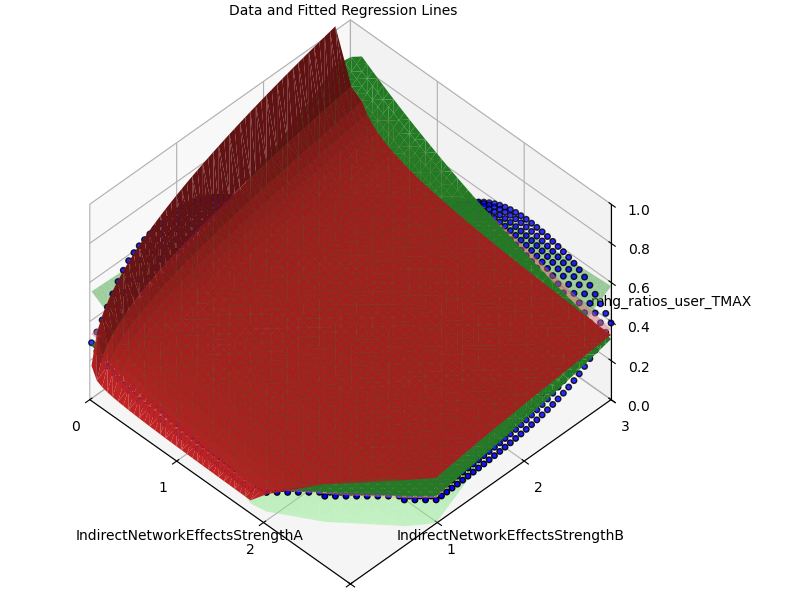

sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored
sys:1: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored


"estimate012_MHGratio_WiiPS3.csv"

In [28]:
using CSV, DataFrames, GLM, Plots, Statistics, StatsBase

# Read the results
df = CSV.read("resultsWiiPS3_3.csv", DataFrame)

# Filter data where mhg_ratios_user_TMAX is greater than 0.12
df = df[df.mhg_ratios_user_TMAX .>= 0.12, :]

# Log transformation
df.mhg_ratios_user_TMAX_log = log.(df.mhg_ratios_user_TMAX)

# Define a linear model
linear_model = lm(@formula(mhg_ratios_user_TMAX ~ IndirectNetworkEffectsStrengthA + IndirectNetworkEffectsStrengthB), df)

# Print the coefficients and formula of the linear model
println("Linear Model Equation: mhg_ratios_user_TMAX = ", coef(linear_model)[1], " + ", coef(linear_model)[2], " * IndirectNetworkEffectsStrengthA + ", coef(linear_model)[3], " * IndirectNetworkEffectsStrengthB")

# Define a model with interaction terms
interaction_model = lm(@formula(mhg_ratios_user_TMAX ~ IndirectNetworkEffectsStrengthA*IndirectNetworkEffectsStrengthB), df)

# Print the coefficients and formula of the interaction model
println("Interaction Model Equation: mhg_ratios_user_TMAX = ", coef(interaction_model)[1], " + ", coef(interaction_model)[2], " * IndirectNetworkEffectsStrengthA + ", coef(interaction_model)[3], " * IndirectNetworkEffectsStrengthB + ", coef(interaction_model)[4], " * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB")

# Define an exponential regression model (requires log transformation)
exp_model = lm(@formula(mhg_ratios_user_TMAX_log ~ IndirectNetworkEffectsStrengthA + IndirectNetworkEffectsStrengthB), df)

# Print the coefficients and formula of the exponential model
println("Exponential Model Equation: log(mhg_ratios_user_TMAX) = ", coef(exp_model)[1], " + ", coef(exp_model)[2], " * IndirectNetworkEffectsStrengthA + ", coef(exp_model)[3], " * IndirectNetworkEffectsStrengthB")

# Define a power regression model (requires log transformation)
power_model = lm(@formula(mhg_ratios_user_TMAX_log ~ log(IndirectNetworkEffectsStrengthA) + log(IndirectNetworkEffectsStrengthB)), df)

# Print the coefficients and formula of the power model
println("Power Model Equation: log(mhg_ratios_user_TMAX) = ", coef(power_model)[1], " + ", coef(power_model)[2], " * log(IndirectNetworkEffectsStrengthA) + ", coef(power_model)[3], " * log(IndirectNetworkEffectsStrengthB)")

# Predicted values
df.prediction_linear = GLM.predict(linear_model, df)
df.prediction_interaction = GLM.predict(interaction_model, df)
df.prediction_exp = exp.(GLM.predict(exp_model, df))
df.prediction_power = exp.(GLM.predict(power_model, df))

# Compute AIC for each model
aic_linear = aic(linear_model)
aic_interaction = aic(interaction_model)
aic_exp = aic(exp_model)
aic_power = aic(power_model)

# Compute Mean Squared Error
MSE_linear = sum((df.prediction_linear .- mean(df.mhg_ratios_user_TMAX)).^2)
MSE_interaction = sum((df.prediction_interaction .- mean(df.mhg_ratios_user_TMAX)).^2)
MSE_exp = sum((df.prediction_exp .- mean(df.mhg_ratios_user_TMAX)).^2)
MSE_power = sum((df.prediction_power .- mean(df.mhg_ratios_user_TMAX)).^2)

# Compute R-squared
TSS = sum((df.mhg_ratios_user_TMAX .- mean(df.mhg_ratios_user_TMAX)).^2)
SSE_linear = sum((df.mhg_ratios_user_TMAX .- df.prediction_linear).^2)
SSE_interaction = sum((df.mhg_ratios_user_TMAX .- df.prediction_interaction).^2)
SSE_exp = sum((df.mhg_ratios_user_TMAX .- df.prediction_exp).^2)
SSE_power = sum((df.mhg_ratios_user_TMAX .- df.prediction_power).^2)
R2_linear = 1 - SSE_linear / TSS
R2_interaction = 1 - SSE_interaction / TSS
R2_exp = 1 - SSE_exp / TSS
R2_power = 1 - SSE_power / TSS

# Display the results in tabular form
println("Linear Model:")
println(coeftable(linear_model))
println("AIC: ", aic_linear)
println("MSE: ", MSE_linear)
println("R-squared: ", R2_linear)
println("---------------")
println("Interaction Model:")
println(coeftable(interaction_model))
println("AIC: ", aic_interaction)
println("MSE: ", MSE_interaction)
println("R-squared: ", R2_interaction)
println("---------------")
println("Exponential Model:")
println(coeftable(exp_model))
println("AIC: ", aic_exp)
println("MSE: ", MSE_exp)
println("R-squared: ", R2_exp)
println("---------------")
println("Power Model:")
println(coeftable(power_model))
println("AIC: ", aic_power)
println("MSE: ", MSE_power)
println("R-squared: ", R2_power)

# Font size for various parts of the plot
fontsize = 10

# 3D plot of original data points and regression lines
p = plot(df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.mhg_ratios_user_TMAX, st=:scatter, title="Data and Fitted Regression Lines", xlabel="IndirectNetworkEffectsStrengthA", ylabel="IndirectNetworkEffectsStrengthB", zlabel="mhg_ratios_user_TMAX", legend=false, guidefontsize=fontsize, tickfontsize=fontsize, titlefontsize=fontsize, color=:blue, camera=(45, 45), size=(800, 600), xlims=(0, 3), ylims=(0, 3), zlims=(0, 1.0))

# add regression lines
plot!(p, df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.prediction_linear, st=:surface, legend=false, color=:reds, alpha=0.5)
plot!(p, df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.prediction_interaction, st=:surface, legend=false, color=:greens, alpha=0.5)
plot!(p, df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.prediction_exp, st=:surface, legend=false, color=:purple, alpha=0.5)
plot!(p, df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB, df.prediction_power, st=:surface, legend=false, color=:yellow, alpha=0.5)

display(p)

# Create a DataFrame for model evaluation
model_evaluation = DataFrame(
    Model = ["Linear", "Interaction", "Exponential", "Power"],
    AIC = [aic_linear, aic_interaction, aic_exp, aic_power],
    MSE = [MSE_linear, MSE_interaction, MSE_exp, MSE_power],
    Rsquared = [R2_linear, R2_interaction, R2_exp, R2_power]
)

# Sort the DataFrame by AIC
sort!(model_evaluation, :AIC)

# Display the DataFrame
println("Model Evaluation:")
println(model_evaluation)

# 画像ファイルとして保存
savefig(p, "estimate012_MHGratio_WiiPS3.png") 

savefig(p, "estimate012_MHGratio_WiiPS3.pdf") 

savefig(p, "estimate012_MHGratio_WiiPS3.svg") 

# CSV形式でmodel_evaluationを保存
CSV.write("estimate012_MHGratio_WiiPS3.csv", model_evaluation)


非線形回帰（非線形最小二乗法）を行う。非線形回帰のためのパッケージ LsqFit.jl を利用する。

In [29]:
using CSV, DataFrames, GLM, Plots, Statistics, StatsBase, LsqFit

# Read the results
df = CSV.read("resultsWiiPS3_3.csv", DataFrame)

println(size(df.IndirectNetworkEffectsStrengthA))
println(size(df.IndirectNetworkEffectsStrengthB))
println(size(df.mhg_ratios_user_TMAX))

function model(x, p)
  p[1] .+ p[2].*x[:,1] .+ p[3].*x[:,2] .+ p[4].*x[:,1].^2 .+ p[5].*x[:,2].^2
end

# Initial guess
p0 = [0.0, 0.0, 0.0, 0.0, 0.0]

# Make sure xdata is a 2-dimensional array by transposing it
ydata = df.mhg_ratios_user_TMAX
xdata = hcat(df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB)

fit = curve_fit(model, xdata, ydata, p0)

# 非線形モデルの係数
coefs = coef(fit)

# Print the coefficients and formula of the nonlinear model
println("Nonlinear Model Equation: mhg_ratios_user_TMAX = ", coefs[1], " + ", coefs[2], " * IndirectNetworkEffectsStrengthA + ", coefs[3], " * IndirectNetworkEffectsStrengthB + ", coefs[4], " * IndirectNetworkEffectsStrengthA^2 + ", coefs[5], " * IndirectNetworkEffectsStrengthB^2")

# Predicted values
df.prediction_nonlinear = model(xdata, coefs)

# Compute residual sum of squares for the nonlinear model
SSE_nonlinear = sum((df.mhg_ratios_user_TMAX .- df.prediction_nonlinear).^2)

# Compute AIC for the nonlinear model
n = length(df.mhg_ratios_user_TMAX)
k = length(coefs)
aic_nonlinear = 2*k + 2*log(SSE_nonlinear/n)

# Compute Mean Squared Error for the nonlinear model
MSE_nonlinear = SSE_nonlinear / n

# Compute R-squared for the nonlinear model
TSS = sum((df.mhg_ratios_user_TMAX .- mean(df.mhg_ratios_user_TMAX)).^2)
R2_nonlinear = 1 - SSE_nonlinear / TSS

# Display the results in tabular form for the nonlinear model
println("Nonlinear Model:")
println("Coefficients: ", coefs)
println("AIC: ", aic_nonlinear)
println("MSE: ", MSE_nonlinear)
println("R-squared: ", R2_nonlinear)

# Create a DataFrame for model evaluation
model_evaluation = DataFrame(
    Model = ["Nonlinear"],
    AIC = [aic_nonlinear],
    MSE = [MSE_nonlinear],
    Rsquared = [R2_nonlinear]
)

# Display the DataFrame
println("Model Evaluation:")
println(model_evaluation)


(2500,)
(2500,)
(2500,)
Nonlinear Model Equation: mhg_ratios_user_TMAX = 0.19412618196205736 + 0.025836505600403074 * IndirectNetworkEffectsStrengthA + 0.27155858756293655 * IndirectNetworkEffectsStrengthB + -0.042554597557522306 * IndirectNetworkEffectsStrengthA^2 + -0.05341485754043648 * IndirectNetworkEffectsStrengthB^2
Nonlinear Model:
Coefficients: [0.19412618196205736, 0.025836505600403074, 0.27155858756293655, -0.042554597557522306, -0.05341485754043648]
AIC: 2.1437093254948163
MSE: 0.01968013874656411
R-squared: 0.5023288440799094
Model Evaluation:
1×4 DataFrame
 Row │ Model      AIC      MSE        Rsquared 
     │ String     Float64  Float64    Float64  
─────┼─────────────────────────────────────────
   1 │ Nonlinear  2.14371  0.0196801  0.502329


非線形回帰（非線形最小二乗法）のために、データを規格化と初期値を変更する。

In [9]:
using CSV, DataFrames, GLM, Plots, Statistics, StatsBase, LsqFit

# Read the results
df = CSV.read("resultsWiiPS3_3.csv", DataFrame)

println(size(df.IndirectNetworkEffectsStrengthA))
println(size(df.IndirectNetworkEffectsStrengthB))
println(size(df.mhg_ratios_user_TMAX))

# Model including interaction term
function model(x, p)
  p[1] .+ p[2].*x[:,1] .+ p[3].*x[:,2] .+ p[4].*x[:,1].^2 .+ p[5].*x[:,2].^2 .+ p[6].*x[:,1].*x[:,2]
end

# Initial guess
p0 = [0.2, 0.03, 0.28, -0.05, -0.06, 0.01] # Add an initial guess for the new parameter

# Make sure xdata is a 2-dimensional array by transposing it
ydata = df.mhg_ratios_user_TMAX
xdata = hcat(df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB)

fit = curve_fit(model, xdata, ydata, p0)

# 非線形モデルの係数
coefs = coef(fit)

# Print the coefficients and formula of the nonlinear model
println("Nonlinear Model Equation: mhg_ratios_user_TMAX = ", coefs[1], " + ", coefs[2], " * IndirectNetworkEffectsStrengthA + ", coefs[3], " * IndirectNetworkEffectsStrengthB + ", coefs[4], " * IndirectNetworkEffectsStrengthA^2 + ", coefs[5], " * IndirectNetworkEffectsStrengthB^2 + ", coefs[6], " * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB")

# Predicted values
df.prediction_nonlinear = model(xdata, coefs)

# Compute residual sum of squares for the nonlinear model
SSE_nonlinear = sum((df.mhg_ratios_user_TMAX .- df.prediction_nonlinear).^2)

# Compute AIC for the nonlinear model
n = length(df.mhg_ratios_user_TMAX)
k = length(coefs)
aic_nonlinear = 2*k + 2*log(SSE_nonlinear/n)

# Compute Mean Squared Error for the nonlinear model
MSE_nonlinear = SSE_nonlinear / n

# Compute R-squared for the nonlinear model
TSS = sum((df.mhg_ratios_user_TMAX .- mean(df.mhg_ratios_user_TMAX)).^2)
R2_nonlinear = 1 - SSE_nonlinear / TSS

# Display the results in tabular form for the nonlinear model
println("Nonlinear Model:")
println("Coefficients: ", coefs)
println("AIC: ", aic_nonlinear)
println("MSE: ", MSE_nonlinear)
println("R-squared: ", R2_nonlinear)

# Create a DataFrame for model evaluation
model_evaluation = DataFrame(
    Model = ["Nonlinear"],
    AIC = [aic_nonlinear],
    MSE = [MSE_nonlinear],
    Rsquared = [R2_nonlinear]
)

# Display the DataFrame
println("Model Evaluation:")
println(model_evaluation)

# CSV形式でmodel_evaluationを保存
CSV.write("estimateNonl_MHGratio_WiiPS3.csv", model_evaluation)


(2500,)
(2500,)
(2500,)
Nonlinear Model Equation: mhg_ratios_user_TMAX = 0.3597791858468102 + -0.08423193551749243 * IndirectNetworkEffectsStrengthA + 0.16149014645111248 * IndirectNetworkEffectsStrengthB + -0.042554597562186235 * IndirectNetworkEffectsStrengthA^2 + -0.05341485754703042 * IndirectNetworkEffectsStrengthB^2 + 0.0731351768324862 * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB
Nonlinear Model:
Coefficients: [0.3597791858468102, -0.08423193551749243, 0.16149014645111248, -0.042554597562186235, -0.05341485754703042, 0.0731351768324862]
AIC: 3.7868523174201645
MSE: 0.016464086577826696
R-squared: 0.5836563398321584
Model Evaluation:
1×4 DataFrame
 Row │ Model      AIC      MSE        Rsquared 
     │ String     Float64  Float64    Float64  
─────┼─────────────────────────────────────────
   1 │ Nonlinear  3.78685  0.0164641  0.583656


"estimateNonl_MHGratio_WiiPS3.csv"

外部ファイルを作成し、等高線図を出力する

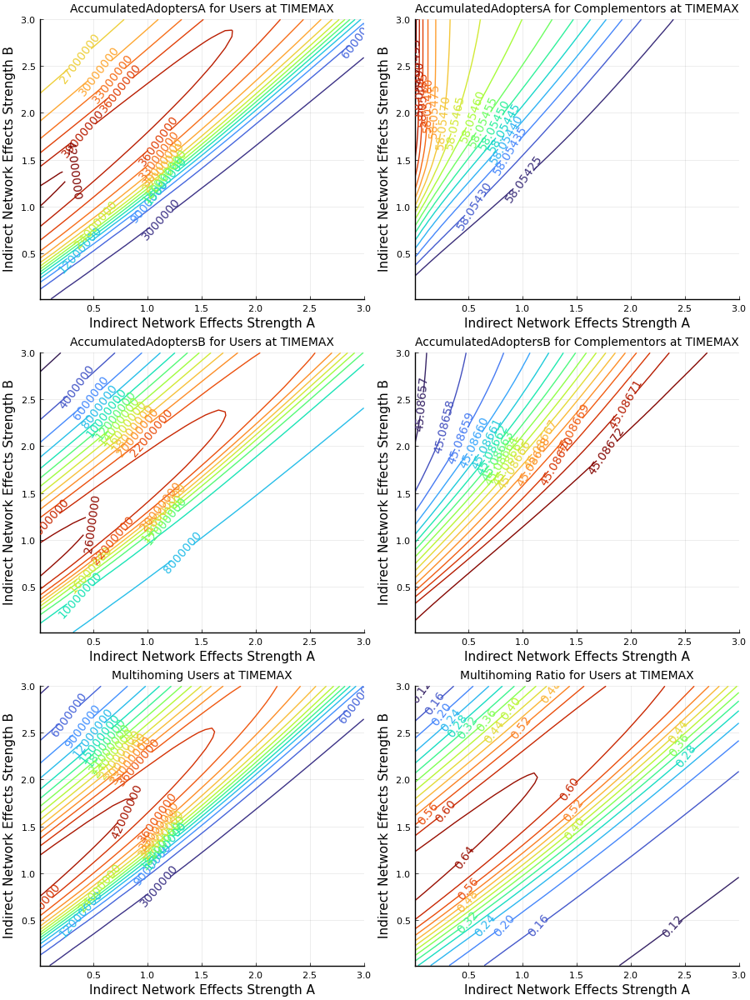

In [30]:
using Plots; pythonplot()
using LaTeXStrings
using CSV, DataFrames

# Save the results to a CSV file
df = DataFrame(
    IndirectNetworkEffectsStrengthA = [r[1] for r in results],
    IndirectNetworkEffectsStrengthB = [r[2] for r in results],
    aAdoptersA_user_TMAX = [r[3] for r in results],
    aAdoptersA_cmpl_TMAX = [r[4] for r in results],
    aAdoptersB_user_TMAX = [r[5] for r in results],
    aAdoptersB_cmpl_TMAX = [r[6] for r in results],
    mhg_user_TMAX = [r[7] for r in results],
    mhg_cmpl_TMAX = [r[8] for r in results],
    mhg_ratios_user_TMAX = [r[9] for r in results],
    mhg_ratios_cmpl_TMAX = [r[10] for r in results]
)
CSV.write("contourWiiPS3.csv", df)

# Define the values for the contour plot
xvals = [r[1] for r in results]
yvals = [r[2] for r in results]
zvals1 = [r[3] for r in results]
zvals2 = [r[4] for r in results]
zvals3 = [r[5] for r in results]
zvals4 = [r[6] for r in results]
zvals5 = [r[7] for r in results]
zvals6 = [r[8] for r in results]
zvals7 = [r[9] for r in results]
zvals8 = [r[10] for r in results]

# Convert the results to a matrix format suitable for contour plot
xvals_mtrx = reshape(xvals, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))
yvals_mtrx = reshape(yvals, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))
zvals1_mtrx = reshape(zvals1, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))
zvals2_mtrx = reshape(zvals2, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))
zvals3_mtrx = reshape(zvals3, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))
zvals4_mtrx = reshape(zvals4, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))
zvals5_mtrx = reshape(zvals5, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))
zvals6_mtrx = reshape(zvals6, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))
zvals7_mtrx = reshape(zvals7, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))
zvals8_mtrx = reshape(zvals8, length(IndirectNetworkEffectsStrengthA_values), length(IndirectNetworkEffectsStrengthB_values))

# Create the contour plots
p1 = contour(xvals_mtrx, yvals_mtrx, zvals1_mtrx, title="AccumulatedAdoptersA for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=15, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10)
p2 = contour(xvals_mtrx, yvals_mtrx, zvals2_mtrx, title="AccumulatedAdoptersA for Complementors at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=15, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10)
p3 = contour(xvals_mtrx, yvals_mtrx, zvals3_mtrx, title="AccumulatedAdoptersB for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=15, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10)
p4 = contour(xvals_mtrx, yvals_mtrx, zvals4_mtrx, title="AccumulatedAdoptersB for Complementors at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=15, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10)
p5 = contour(xvals_mtrx, yvals_mtrx, zvals5_mtrx, title="Multihoming Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=15, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10)
p6 = contour(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=15, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10)

# Display the plot with larger size
display(plot(p1, p2, p3, p4, p5, p6, layout = (3, 2), legend = false, size = (900, 1200)))

総天然色等高線図を出力する

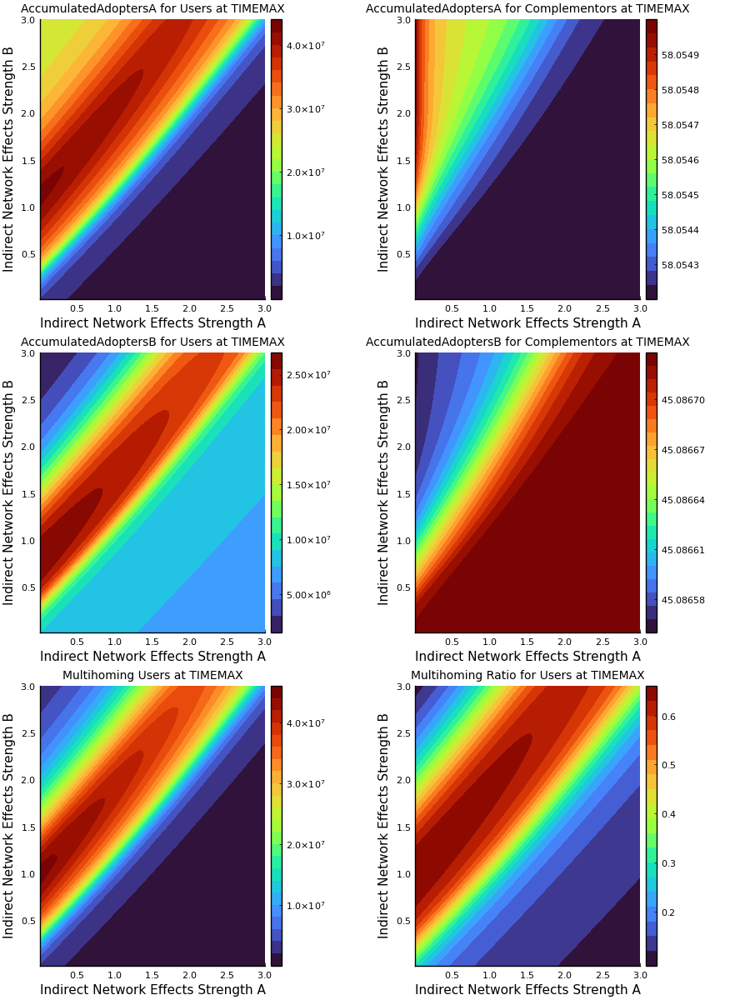

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'


In [31]:
using Plots
plot()

# Create the contour plots
p1 = contourf(xvals_mtrx, yvals_mtrx, zvals1_mtrx, title="AccumulatedAdoptersA for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10)
p2 = contourf(xvals_mtrx, yvals_mtrx, zvals2_mtrx, title="AccumulatedAdoptersA for Complementors at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10)
p3 = contourf(xvals_mtrx, yvals_mtrx, zvals3_mtrx, title="AccumulatedAdoptersB for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10)
p4 = contourf(xvals_mtrx, yvals_mtrx, zvals4_mtrx, title="AccumulatedAdoptersB for Complementors at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10)
p5 = contourf(xvals_mtrx, yvals_mtrx, zvals5_mtrx, title="Multihoming Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10)
p6 = contourf(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=20, color=:turbo, titlefontsize=10)

# Display the plot with larger size
display(plot(p1, p2, p3, p4, p5, p6, layout = (3, 2), legend = false, size = (900, 1200)))

総天然色等高線図をファイル出力する

In [32]:
using Plots
plot()

# Create the combined plot
p = plot(p1, p2, p3, p4, p5, p6, layout = (3, 2), legend = false, size = (900, 1200))

# Save the contour plot to a PNG file
savefig(p, "fullcontourWiiPS3.png")

# Save the contour plot to a PDF file
savefig(p, "fullcontourWiiPS3.pdf")

# Save the contour plot to a EPS file
savefig(p, "fullcontourWiiPS3.eps")

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\fullcontourWiiPS3.eps"

マルチホーミング率の等高線図のみを描画する

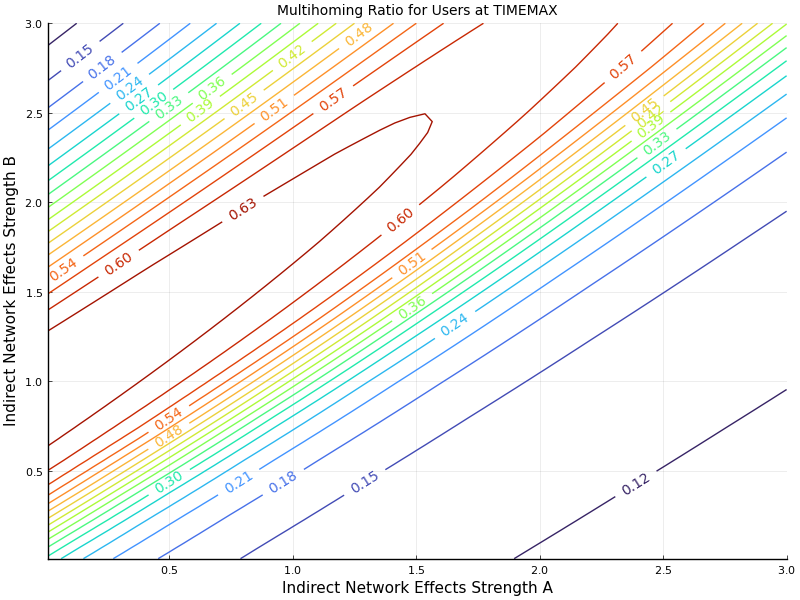

In [33]:
using Plots
plot()

contour(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10, size = (800, 600))

マルチホーミング率の等高線図をファイル出力する

In [34]:
using Plots
plot()

p = contour(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=20, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10, size = (800, 600))

# Save the contour plot to a PNG file
savefig(p, "contourMHGratioWiiPS3.png")

# Save the contour plot to a PDF file
savefig(p, "contourMHGratioWiiPS3.pdf")


"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\contourMHGratioWiiPS3.pdf"

マルチホーミング率の総天然色等高線図のみを描画する

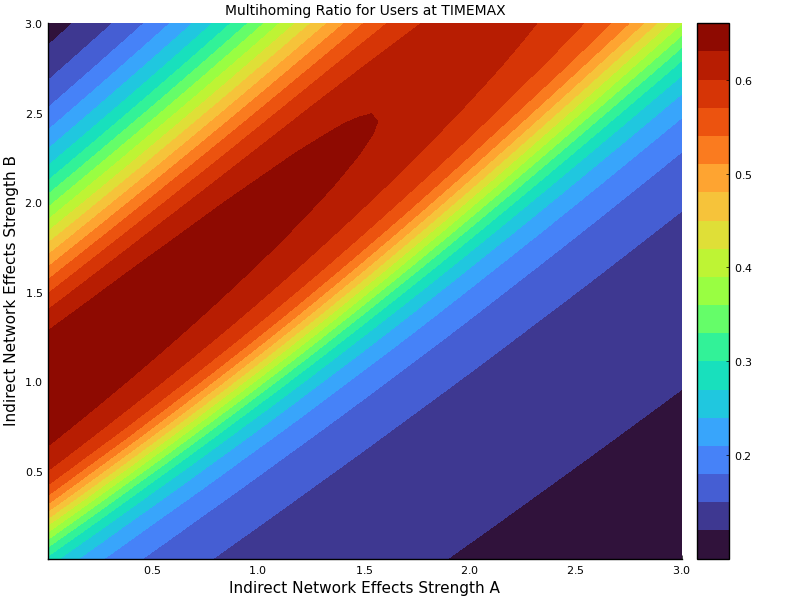

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'


In [35]:
using Plots
plot()

contourf(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10, size = (800, 600))

マルチホーミング率の総天然色等高線図のみを外部出力する

In [36]:
using Plots
plot()

p = contourf(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10, size = (800, 600))

# Save the contour plot to a PNG file
savefig(p, "fullcontourMHGratioWiiPS3.png")

# Save the contour plot to a PDF file
savefig(p, "fullcontourMHGratioWiiPS3.pdf")

# Save the contour plot to a EPS file
savefig(p, "fullcontourMHGratioWiiPS3.eps")


sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\fullcontourMHGratioWiiPS3.eps"

交互作用モデル mhg_ratios_user_TMAX = 0.5566492052470285 + -0.2790748992254003 * IndirectNetworkEffectsStrengthA + -0.02185710270633754 * IndirectNetworkEffectsStrengthB + 0.10299606755817325 * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthBの推定式から得られる等高線を描く.

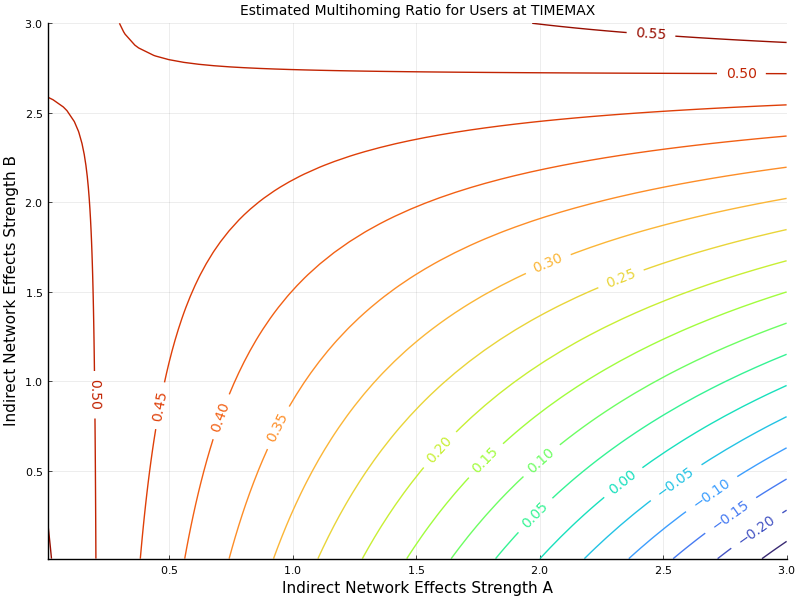

In [37]:
using CSV, DataFrames, Plots

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Calculate model predictions
data[!, :model_predictions] =  0.5566492052470285 .+
-0.2790748992254003 .* data[!, :IndirectNetworkEffectsStrengthA] .+
-0.02185710270633754 .* data[!, :IndirectNetworkEffectsStrengthB] .+
0.10299606755817325 .* data[!, :IndirectNetworkEffectsStrengthA] .* data[!, :IndirectNetworkEffectsStrengthB]

# Define the grid for x and y
gridA = sort(unique(data[!, :IndirectNetworkEffectsStrengthA]))
gridB = sort(unique(data[!, :IndirectNetworkEffectsStrengthB]))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Create the contour plot
contour(gridA, gridB, predictions_matrix, 
        title="Estimated Multihoming Ratio for Users at TIMEMAX", 
        xlabel="Indirect Network Effects Strength A", 
        ylabel="Indirect Network Effects Strength B", 
        levels=20, color=:turbo, clabels=true, cbar=false, lw=1, 
        titlefontsize=10, size = (800, 600))


線形モデルLinear Model Equation: mhg_ratios_user_TMAX = 0.33635818744881013 + -0.10673314319063988 * IndirectNetworkEffectsStrengthA + 0.11523435664064482 * IndirectNetworkEffectsStrengthBの推定式から得らえる等高線を描く。

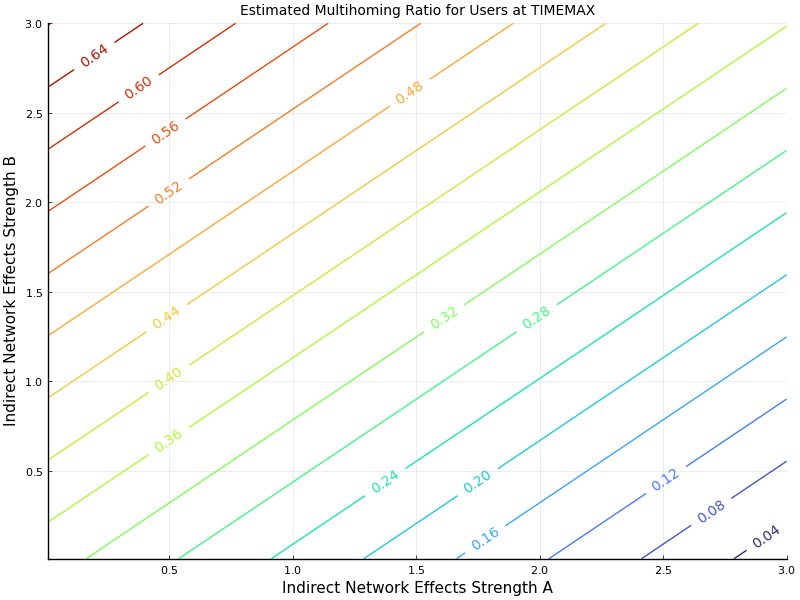

In [38]:
using CSV, DataFrames, Plots

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Calculate model predictions for the new linear model
data[!, :model_predictions] =  0.33635818744881013 .+
                               -0.10673314319063988 .* data[!, :IndirectNetworkEffectsStrengthA] .+
                               0.11523435664064482 .* data[!, :IndirectNetworkEffectsStrengthB]

# Define the grid for x and y
gridA = sort(unique(data[!, :IndirectNetworkEffectsStrengthA]))
gridB = sort(unique(data[!, :IndirectNetworkEffectsStrengthB]))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Create the contour plot
contour(gridA, gridB, predictions_matrix, 
        title="Estimated Multihoming Ratio for Users at TIMEMAX", 
        xlabel="Indirect Network Effects Strength A", 
        ylabel="Indirect Network Effects Strength B", 
        levels=20, color=:turbo, clabels=true, cbar=false, lw=1, 
        titlefontsize=10, size = (800, 600))


非線形モデルLinear Model Equation: mhg_ratios_user_TMAX = 0.19412618196305564 + 0.025836505599496684 * IndirectNetworkEffectsStrengthA + 0.2715585875624955 * IndirectNetworkEffectsStrengthB + -0.04255459755726991 * IndirectNetworkEffectsStrengthA^2 + -0.05341485754032789 * IndirectNetworkEffectsStrengthB^2Bの推定式から得らえる等高線を描く。

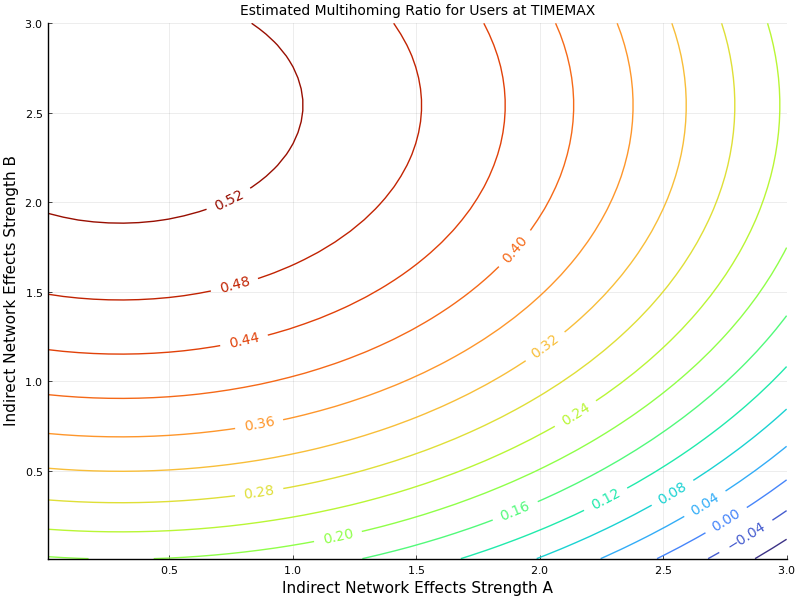

In [39]:
using CSV, DataFrames, Plots

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Calculate model predictions for the new nonlinear model
data[!, :model_predictions] =  0.19412618196305564 .+
                               0.025836505599496684 .* data[!, :IndirectNetworkEffectsStrengthA] .+
                               0.2715585875624955 .* data[!, :IndirectNetworkEffectsStrengthB] .+
                               -0.04255459755726991 .* data[!, :IndirectNetworkEffectsStrengthA].^2 .+
                               -0.05341485754032789 .* data[!, :IndirectNetworkEffectsStrengthB].^2

# Define the grid for x and y
gridA = sort(unique(data[!, :IndirectNetworkEffectsStrengthA]))
gridB = sort(unique(data[!, :IndirectNetworkEffectsStrengthB]))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Create the contour plot
contour(gridA, gridB, predictions_matrix, 
        title="Estimated Multihoming Ratio for Users at TIMEMAX", 
        xlabel="Indirect Network Effects Strength A", 
        ylabel="Indirect Network Effects Strength B", 
        levels=20, color=:turbo, clabels=true, cbar=false, lw=1, 
        titlefontsize=10, size = (800, 600))

非線形モデル Nonlinear Model Equation: mhg_ratios_user_TMAX = 0.359779185865958 + -0.08423193553297714 * IndirectNetworkEffectsStrengthA + 0.1614901464353081 * IndirectNetworkEffectsStrengthB + -0.042554597558599125 * IndirectNetworkEffectsStrengthA^2 + -0.053414857543342076 * IndirectNetworkEffectsStrengthB^2 + 0.07313517683511794 * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB
の推定式から得らえる等高線を描く。

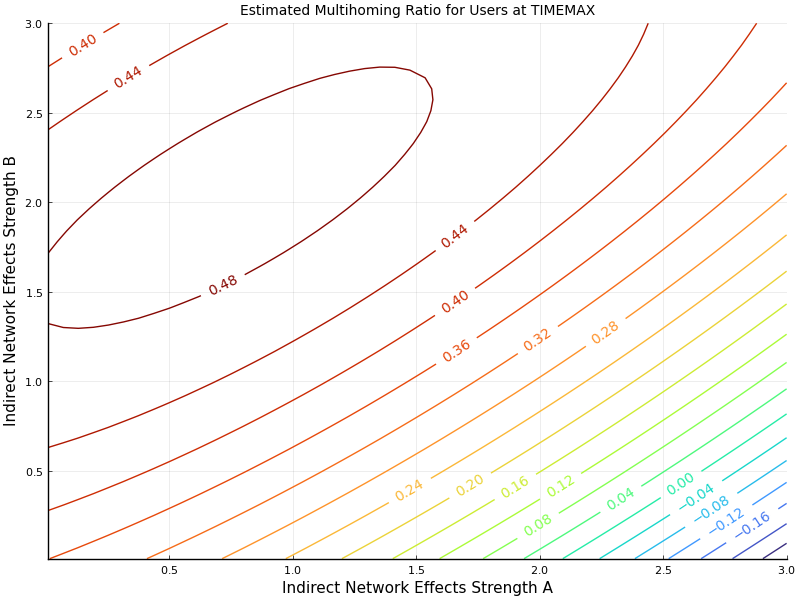

"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\estimateNonl_MHGratio_WiiPS3.svg"

In [40]:
using CSV, DataFrames, Plots

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Calculate model predictions for the new nonlinear model
data[!, :model_predictions] =  0.359779185865958 .+
                               -0.08423193553297714 .* data[!, :IndirectNetworkEffectsStrengthA] .+
                               0.1614901464353081 .* data[!, :IndirectNetworkEffectsStrengthB] .+
                               -0.042554597558599125 .* data[!, :IndirectNetworkEffectsStrengthA].^2 .+
                               -0.053414857543342076 .* data[!, :IndirectNetworkEffectsStrengthB].^2 .+
                               0.07313517683511794 .* data[!, :IndirectNetworkEffectsStrengthA] .* data[!, :IndirectNetworkEffectsStrengthB]

# Define the grid for x and y
gridA = sort(unique(data[!, :IndirectNetworkEffectsStrengthA]))
gridB = sort(unique(data[!, :IndirectNetworkEffectsStrengthB]))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Create the contour plot
p = contour(gridA, gridB, predictions_matrix, 
        title="Estimated Multihoming Ratio for Users at TIMEMAX", 
        xlabel="Indirect Network Effects Strength A", 
        ylabel="Indirect Network Effects Strength B", 
        levels=21, color=:turbo, clabels=true, cbar=false, lw=1, 
        titlefontsize=10, size = (800, 600))

display(p)

# 画像ファイルとして保存
savefig(p, "estimateNonl_MHGratio_WiiPS3.png") 

savefig(p, "estimateNonl_MHGratio_WiiPS3.pdf") 

savefig(p, "estimateNonl_MHGratio_WiiPS3.svg") 


シミュレーションから得られたマルチホーミング率の等高線図と非線形回帰の推定式から得られる等高線図を出力する．(1)

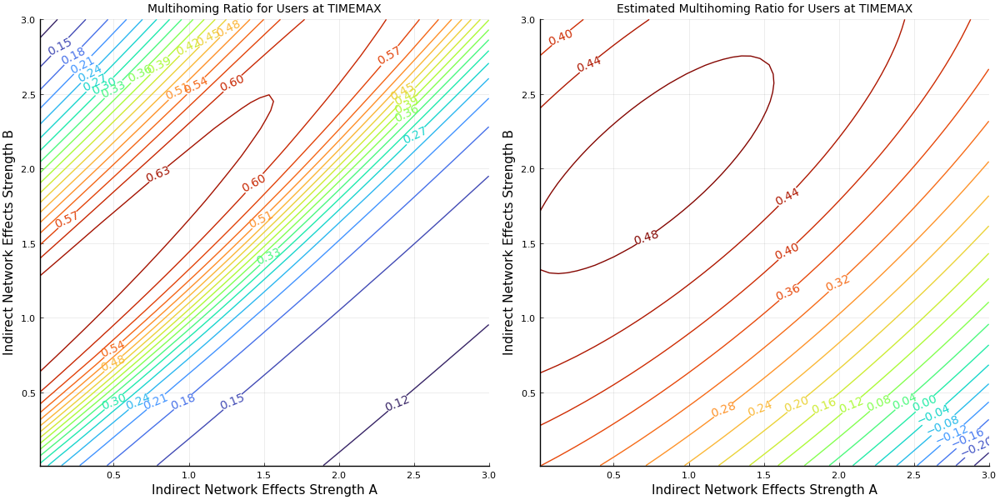

"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\comparison_MHGratio_WiiPS3.svg"

In [41]:
using CSV, DataFrames
using Plots
using LaTeXStrings

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Define the values for the contour plot
xvals = data[:, :IndirectNetworkEffectsStrengthA]
yvals = data[:, :IndirectNetworkEffectsStrengthB]
zvals7 = data[:, :mhg_ratios_user_TMAX]

# Calculate model predictions for the new nonlinear model
data[!, :model_predictions] =  0.359779185865958 .+
                               -0.08423193553297714 .* xvals .+
                               0.1614901464353081 .* yvals .+
                               -0.042554597558599125 .* xvals.^2 .+
                               -0.053414857543342076 .* yvals.^2 .+
                               0.07313517683511794 .* xvals .* yvals

# Define the grid for x and y
gridA = sort(unique(xvals))
gridB = sort(unique(yvals))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Convert the results to a matrix format suitable for contour plot
xvals_mtrx = reshape(xvals, length(gridA), length(gridB))
yvals_mtrx = reshape(yvals, length(gridA), length(gridB))
zvals7_mtrx = reshape(zvals7, length(gridA), length(gridB))

# Create a plot with 2 subplots
p1 = contour(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10)

p2 = contour(gridA, gridB, predictions_matrix, 
             title="Estimated Multihoming Ratio for Users at TIMEMAX", 
             xlabel="Indirect Network Effects Strength A", 
             ylabel="Indirect Network Effects Strength B", 
             levels=21, color=:turbo, clabels=true, cbar=false, lw=1, 
             titlefontsize=10)

p = plot(p1, p2, layout = (1, 2), size = (1200, 600))

display(p)

# 画像ファイルとして保存
savefig(p, "comparison_MHGratio_WiiPS3.png") 

savefig(p, "comparison_MHGratio_WiiPS3.pdf") 

savefig(p, "comparison_MHGratio_WiiPS3.svg") 

シミュレーションから得られたマルチホーミング率の等高線図と非線形回帰の推定式から得られる総天然色等高線図を出力する．(1)

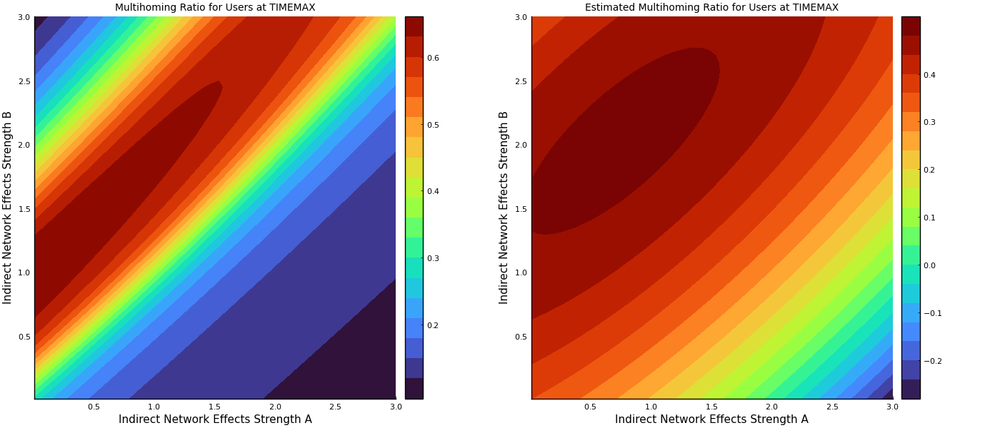

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'


"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\comparisonFull_MHGratio_WiiPS3.svg"

In [42]:
using CSV, DataFrames
using Plots
using LaTeXStrings

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Define the values for the contour plot
xvals = data[:, :IndirectNetworkEffectsStrengthA]
yvals = data[:, :IndirectNetworkEffectsStrengthB]
zvals7 = data[:, :mhg_ratios_user_TMAX]

# Calculate model predictions for the new nonlinear model
data[!, :model_predictions] =  0.359779185865958 .+
                               -0.08423193553297714 .* xvals .+
                               0.1614901464353081 .* yvals .+
                               -0.042554597558599125 .* xvals.^2 .+
                               -0.053414857543342076 .* yvals.^2 .+
                               0.07313517683511794 .* xvals .* yvals

# Define the grid for x and y
gridA = sort(unique(xvals))
gridB = sort(unique(yvals))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Convert the results to a matrix format suitable for contour plot
xvals_mtrx = reshape(xvals, length(gridA), length(gridB))
yvals_mtrx = reshape(yvals, length(gridA), length(gridB))
zvals7_mtrx = reshape(zvals7, length(gridA), length(gridB))

# Create a plot with 2 subplots
p1 = contourf(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10)

p2 = contourf(gridA, gridB, predictions_matrix, 
             title="Estimated Multihoming Ratio for Users at TIMEMAX", 
             xlabel="Indirect Network Effects Strength A", 
             ylabel="Indirect Network Effects Strength B", 
             levels=21, color=:turbo,  
             titlefontsize=10)

p = plot(p1, p2, layout = (1, 2), size = (1400, 600))

display(p)

# 画像ファイルとして保存
savefig(p, "comparisonFull_MHGratio_WiiPS3.png") 

savefig(p, "comparisonFull_MHGratio_WiiPS3.pdf") 

savefig(p, "comparisonFull_MHGratio_WiiPS3.svg") 



mhg_ratios_user_TMAXが0.12 以上のデータのみを用いて交差項を含む非線形回帰（非線形最小二乗法）モデルを生成する．モデルの評価指標（AIC、MSE、R2）を算出し、表形式で表示する。

In [44]:
using CSV, DataFrames, GLM, Plots, Statistics, StatsBase, LsqFit

# Read the results
df = CSV.read("contourWiiPS3.csv", DataFrame)

# Filter data where mhg_ratios_user_TMAX is greater than 0.12
df = df[df.mhg_ratios_user_TMAX .>= 0.12, :]

println(size(df.IndirectNetworkEffectsStrengthA))
println(size(df.IndirectNetworkEffectsStrengthB))
println(size(df.mhg_ratios_user_TMAX))

# Model including interaction term
function model(x, p)
  p[1] .+ p[2].*x[:,1] .+ p[3].*x[:,2] .+ p[4].*x[:,1].^2 .+ p[5].*x[:,2].^2 .+ p[6].*x[:,1].*x[:,2]
end

# Initial guess
p0 = [0.2, 0.03, 0.28, -0.05, -0.06, 0.01] # Add an initial guess for the new parameter

# Make sure xdata is a 2-dimensional array by transposing it
ydata = df.mhg_ratios_user_TMAX
xdata = hcat(df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB)

fit = curve_fit(model, xdata, ydata, p0)

# 非線形モデルの係数
coefs = coef(fit)

# Print the coefficients and formula of the nonlinear model
println("Nonlinear Model Equation: mhg_ratios_user_TMAX = ", coefs[1], " + ", coefs[2], " * IndirectNetworkEffectsStrengthA + ", coefs[3], " * IndirectNetworkEffectsStrengthB + ", coefs[4], " * IndirectNetworkEffectsStrengthA^2 + ", coefs[5], " * IndirectNetworkEffectsStrengthB^2 + ", coefs[6], " * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB")

# Predicted values
df.prediction_nonlinear = model(xdata, coefs)

# Compute residual sum of squares for the nonlinear model
SSE_nonlinear = sum((df.mhg_ratios_user_TMAX .- df.prediction_nonlinear).^2)

# Compute AIC for the nonlinear model
n = length(df.mhg_ratios_user_TMAX)
k = length(coefs)
aic_nonlinear = 2*k + 2*log(SSE_nonlinear/n)

# Compute Mean Squared Error for the nonlinear model
MSE_nonlinear = SSE_nonlinear / n

# Compute R-squared for the nonlinear model
TSS = sum((df.mhg_ratios_user_TMAX .- mean(df.mhg_ratios_user_TMAX)).^2)
R2_nonlinear = 1 - SSE_nonlinear / TSS

# Display the results in tabular form for the nonlinear model
println("Nonlinear Model:")
println("Coefficients: ", coefs)
println("AIC: ", aic_nonlinear)
println("MSE: ", MSE_nonlinear)
println("R-squared: ", R2_nonlinear)

# Create a DataFrame for model evaluation
model_evaluation = DataFrame(
    Model = ["Nonlinear"],
    AIC = [aic_nonlinear],
    MSE = [MSE_nonlinear],
    Rsquared = [R2_nonlinear]
)

# Display the DataFrame
println("Model Evaluation:")
println(model_evaluation)

(2340,)
(2340,)
(2340,)
Nonlinear Model Equation: mhg_ratios_user_TMAX = 0.35306431489245077 + -0.10681291201395168 * IndirectNetworkEffectsStrengthA + 0.24062028577450995 * IndirectNetworkEffectsStrengthB + -0.0816037542122149 * IndirectNetworkEffectsStrengthA^2 + -0.09752608880935464 * IndirectNetworkEffectsStrengthB^2 + 0.13801855276892977 * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB
Nonlinear Model:
Coefficients: [0.35306431489245077, -0.10681291201395168, 0.24062028577450995, -0.0816037542122149, -0.09752608880935464, 0.13801855276892977]
AIC: 3.1034104286271837
MSE: 0.011698498418821531
R-squared: 0.6944045622149702
Model Evaluation:
1×4 DataFrame
 Row │ Model      AIC      MSE        Rsquared 
     │ String     Float64  Float64    Float64  
─────┼─────────────────────────────────────────
   1 │ Nonlinear  3.10341  0.0116985  0.694405


mhg_ratios_user_TMAXが0.36 以上のデータのみを用いて交差項を含む非線形回帰（非線形最小二乗法）モデルを生成する．モデルの評価指標（AIC、MSE、R2）を算出し、表形式で表示する。

In [45]:
using CSV, DataFrames, GLM, Plots, Statistics, StatsBase, LsqFit

# Read the results
df = CSV.read("contourWiiPS3.csv", DataFrame)

# Filter data where mhg_ratios_user_TMAX is greater than 0.36
df = df[df.mhg_ratios_user_TMAX .>= 0.36, :]

println(size(df.IndirectNetworkEffectsStrengthA))
println(size(df.IndirectNetworkEffectsStrengthB))
println(size(df.mhg_ratios_user_TMAX))

# Model including interaction term
function model(x, p)
  p[1] .+ p[2].*x[:,1] .+ p[3].*x[:,2] .+ p[4].*x[:,1].^2 .+ p[5].*x[:,2].^2 .+ p[6].*x[:,1].*x[:,2]
end

# Initial guess
p0 = [0.2, 0.03, 0.28, -0.05, -0.06, 0.01] # Add an initial guess for the new parameter

# Make sure xdata is a 2-dimensional array by transposing it
ydata = df.mhg_ratios_user_TMAX
xdata = hcat(df.IndirectNetworkEffectsStrengthA, df.IndirectNetworkEffectsStrengthB)

fit = curve_fit(model, xdata, ydata, p0)

# 非線形モデルの係数
coefs = coef(fit)

# Print the coefficients and formula of the nonlinear model
println("Nonlinear Model Equation: mhg_ratios_user_TMAX = ", coefs[1], " + ", coefs[2], " * IndirectNetworkEffectsStrengthA + ", coefs[3], " * IndirectNetworkEffectsStrengthB + ", coefs[4], " * IndirectNetworkEffectsStrengthA^2 + ", coefs[5], " * IndirectNetworkEffectsStrengthB^2 + ", coefs[6], " * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB")

# Predicted values
df.prediction_nonlinear = model(xdata, coefs)

# Compute residual sum of squares for the nonlinear model
SSE_nonlinear = sum((df.mhg_ratios_user_TMAX .- df.prediction_nonlinear).^2)

# Compute AIC for the nonlinear model
n = length(df.mhg_ratios_user_TMAX)
k = length(coefs)
aic_nonlinear = 2*k + 2*log(SSE_nonlinear/n)

# Compute Mean Squared Error for the nonlinear model
MSE_nonlinear = SSE_nonlinear / n

# Compute R-squared for the nonlinear model
TSS = sum((df.mhg_ratios_user_TMAX .- mean(df.mhg_ratios_user_TMAX)).^2)
R2_nonlinear = 1 - SSE_nonlinear / TSS

# Display the results in tabular form for the nonlinear model
println("Nonlinear Model:")
println("Coefficients: ", coefs)
println("AIC: ", aic_nonlinear)
println("MSE: ", MSE_nonlinear)
println("R-squared: ", R2_nonlinear)

# Create a DataFrame for model evaluation
model_evaluation = DataFrame(
    Model = ["Nonlinear"],
    AIC = [aic_nonlinear],
    MSE = [MSE_nonlinear],
    Rsquared = [R2_nonlinear]
)

# Display the DataFrame
println("Model Evaluation:")
println(model_evaluation)

# CSV形式でmodel_evaluationを保存
CSV.write("estimateNonl036_MHGratio_WiiPS3.csv", model_evaluation)

(1133,)
(1133,)
(1133,)
Nonlinear Model Equation: mhg_ratios_user_TMAX = 0.36122988645445847 + -0.5258659368518369 * IndirectNetworkEffectsStrengthA + 0.5860822421517543 * IndirectNetworkEffectsStrengthB + -0.2749577306914602 * IndirectNetworkEffectsStrengthA^2 + -0.2999364191829589 * IndirectNetworkEffectsStrengthB^2 + 0.5585473534156509 * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB
Nonlinear Model:
Coefficients: [0.36122988645445847, -0.5258659368518369, 0.5860822421517543, -0.2749577306914602, -0.2999364191829589, 0.5585473534156509]
AIC: -5.763878516206411
MSE: 0.00013887459058339288
R-squared: 0.9812748414328966
Model Evaluation:
1×4 DataFrame
 Row │ Model      AIC       MSE          Rsquared 
     │ String     Float64   Float64      Float64  
─────┼────────────────────────────────────────────
   1 │ Nonlinear  -5.76388  0.000138875  0.981275


"estimateNonl036_MHGratio_WiiPS3.csv"

非線形モデル Nonlinear Model Equation:  mhg_ratios_user_TMAX = 0.36122988645383125 + -0.5258659368524684 * IndirectNetworkEffectsStrengthA + 0.5860822421528916 * IndirectNetworkEffectsStrengthB + -0.2749577306917354 * IndirectNetworkEffectsStrengthA^2 + -0.29993641918341807 * IndirectNetworkEffectsStrengthB^2 + 0.5585473534162707 * IndirectNetworkEffectsStrengthA * IndirectNetworkEffectsStrengthB の推定式から得らえる等高線を描く。

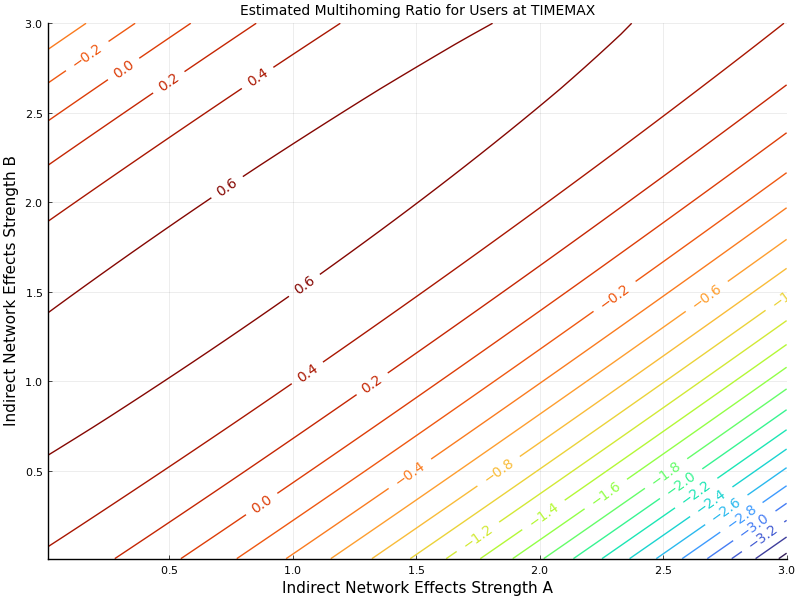

"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\estimateNonl036_MHGratio_WiiPS3.svg"

In [46]:
using CSV, DataFrames
using Plots
using LaTeXStrings

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Calculate model predictions for each row in the data
data[!, :model_predictions] = 0.36122988645383125 .+
                              -0.5258659368524684 .* data[!, :IndirectNetworkEffectsStrengthA] .+
                              0.5860822421528916 .* data[!, :IndirectNetworkEffectsStrengthB] .+
                              -0.2749577306917354 .* data[!, :IndirectNetworkEffectsStrengthA].^2 .+
                              -0.29993641918341807 .* data[!, :IndirectNetworkEffectsStrengthB].^2 .+
                              0.5585473534162707 .* data[!, :IndirectNetworkEffectsStrengthA] .* data[!, :IndirectNetworkEffectsStrengthB]

# Define the grid for x and y
gridA = sort(unique(data[!, :IndirectNetworkEffectsStrengthA]))
gridB = sort(unique(data[!, :IndirectNetworkEffectsStrengthB]))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Create the contour plot
p = contour(gridA, gridB, predictions_matrix, 
        title="Estimated Multihoming Ratio for Users at TIMEMAX", 
        xlabel="Indirect Network Effects Strength A", 
        ylabel="Indirect Network Effects Strength B", 
        levels=21, color=:turbo, clabels=true, cbar=false, lw=1, 
        titlefontsize=10, size = (800, 600))

display(p)

# 画像ファイルとして保存
savefig(p, "estimateNonl036_MHGratio_WiiPS3.png") 

savefig(p, "estimateNonl036_MHGratio_WiiPS3.pdf") 

savefig(p, "estimateNonl036_MHGratio_WiiPS3.svg") 

シミュレーションから得られたマルチホーミング率の等高線図と非線形回帰の推定式から得られる等高線図を出力する．(2)
推定されたマルチホーミング率が負の値の場合に、強制的に0値を設定する．

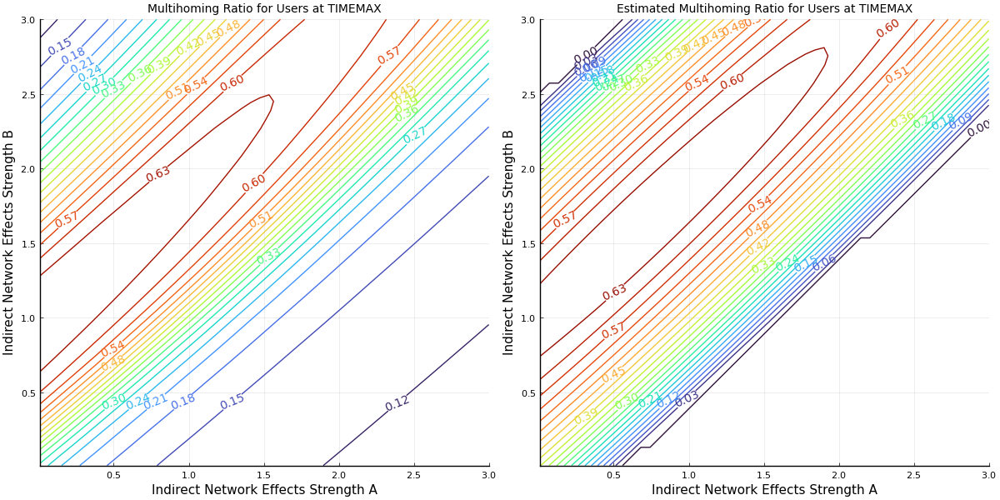

"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\comparison_MHGratio_WiiPS3.svg"

In [47]:
using CSV, DataFrames
using Plots
using LaTeXStrings

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Define the values for the contour plot
xvals = data[:, :IndirectNetworkEffectsStrengthA]
yvals = data[:, :IndirectNetworkEffectsStrengthB]
zvals7 = data[:, :mhg_ratios_user_TMAX]

# Calculate model predictions for each row in the data
data[!, :model_predictions] = 0.36122988645383125 .+
                              -0.5258659368524684 .* data[!, :IndirectNetworkEffectsStrengthA] .+
                              0.5860822421528916 .* data[!, :IndirectNetworkEffectsStrengthB] .+
                              -0.2749577306917354 .* data[!, :IndirectNetworkEffectsStrengthA].^2 .+
                              -0.29993641918341807 .* data[!, :IndirectNetworkEffectsStrengthB].^2 .+
                              0.5585473534162707 .* data[!, :IndirectNetworkEffectsStrengthA] .* data[!, :IndirectNetworkEffectsStrengthB]

# If the model prediction is negative, set it to 0
data[!, :model_predictions] = max.(0, data[!, :model_predictions])

# Define the grid for x and y
gridA = sort(unique(xvals))
gridB = sort(unique(yvals))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Convert the results to a matrix format suitable for contour plot
xvals_mtrx = reshape(xvals, length(gridA), length(gridB))
yvals_mtrx = reshape(yvals, length(gridA), length(gridB))
zvals7_mtrx = reshape(zvals7, length(gridA), length(gridB))

# Create a plot with 2 subplots
p1 = contour(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, clabels=true, cbar=false, lw=1, titlefontsize=10)

p2 = contour(gridA, gridB, predictions_matrix, 
             title="Estimated Multihoming Ratio for Users at TIMEMAX", 
             xlabel="Indirect Network Effects Strength A", 
             ylabel="Indirect Network Effects Strength B", 
             levels=21, color=:turbo, clabels=true, cbar=false, lw=1, 
             titlefontsize=10)

p = plot(p1, p2, layout = (1, 2), size = (1200, 600))

display(p)

# 画像ファイルとして保存
savefig(p, "comparison_MHGratio_WiiPS3.png") 

savefig(p, "comparison_MHGratio_WiiPS3.pdf") 

savefig(p, "comparison_MHGratio_WiiPS3.svg") 

シミュレーションから得られたマルチホーミング率の等高線図と非線形回帰の推定式から得られる総天然色等高線図を出力する．(2)

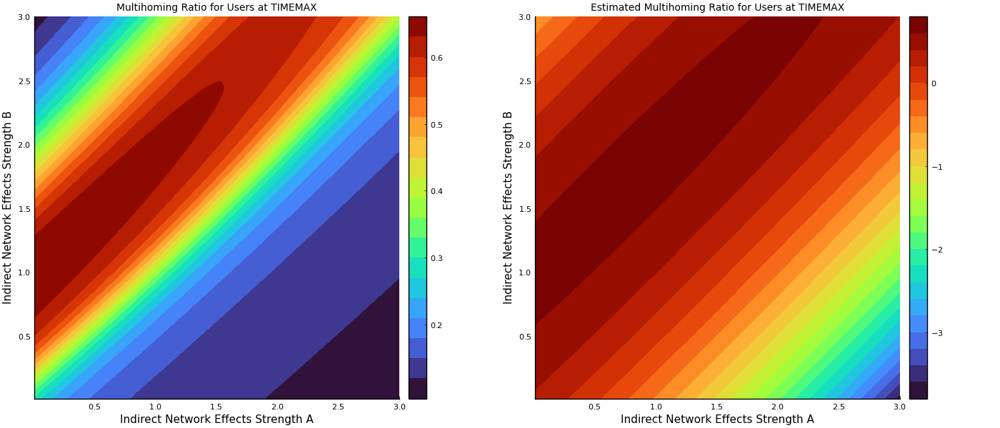

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'


"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\comparisonFull_MHGratio_WiiPS3.svg"

In [48]:
using CSV, DataFrames
using Plots
using LaTeXStrings

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Define the values for the contour plot
xvals = data[:, :IndirectNetworkEffectsStrengthA]
yvals = data[:, :IndirectNetworkEffectsStrengthB]
zvals7 = data[:, :mhg_ratios_user_TMAX]


# Calculate model predictions for each row in the data
data[!, :model_predictions] = 0.36122988645383125 .+
                              -0.5258659368524684 .* data[!, :IndirectNetworkEffectsStrengthA] .+
                              0.5860822421528916 .* data[!, :IndirectNetworkEffectsStrengthB] .+
                              -0.2749577306917354 .* data[!, :IndirectNetworkEffectsStrengthA].^2 .+
                              -0.29993641918341807 .* data[!, :IndirectNetworkEffectsStrengthB].^2 .+
                              0.5585473534162707 .* data[!, :IndirectNetworkEffectsStrengthA] .* data[!, :IndirectNetworkEffectsStrengthB]

# Define the grid for x and y
gridA = sort(unique(xvals))
gridB = sort(unique(yvals))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Convert the results to a matrix format suitable for contour plot
xvals_mtrx = reshape(xvals, length(gridA), length(gridB))
yvals_mtrx = reshape(yvals, length(gridA), length(gridB))
zvals7_mtrx = reshape(zvals7, length(gridA), length(gridB))

# Create a plot with 2 subplots
p1 = contourf(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10)

p2 = contourf(gridA, gridB, predictions_matrix, 
             title="Estimated Multihoming Ratio for Users at TIMEMAX", 
             xlabel="Indirect Network Effects Strength A", 
             ylabel="Indirect Network Effects Strength B", 
             levels=21, color=:turbo,
             titlefontsize=10)

p = plot(p1, p2, layout = (1, 2), size = (1400, 600))

display(p)

# 画像ファイルとして保存
savefig(p, "comparisonFull_MHGratio_WiiPS3.png") 

savefig(p, "comparisonFull_MHGratio_WiiPS3.pdf") 

savefig(p, "comparisonFull_MHGratio_WiiPS3.svg") 


シミュレーションから得られたマルチホーミング率の等高線図と非線形回帰の推定式から得られる総天然色等高線図を出力する．(3)
推定されたマルチホーミング率が負の値の場合に、強制的に0.05値を設定する．

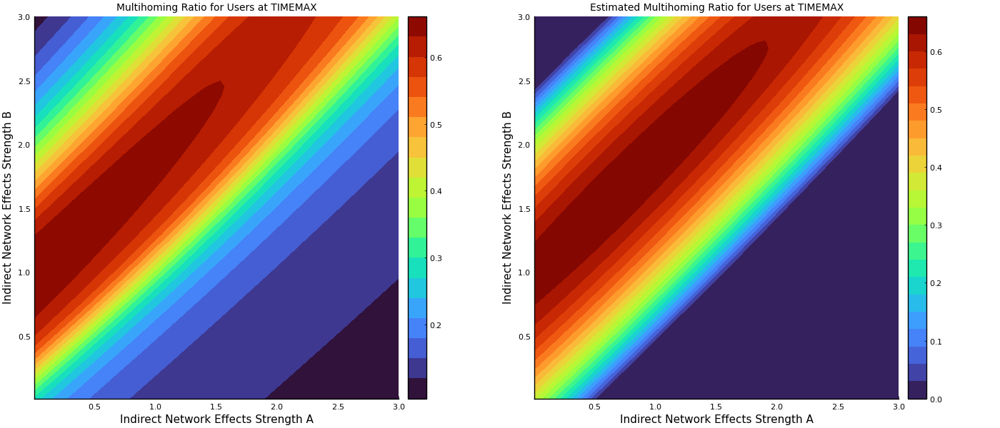

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'


"d:\\Dropbox\\JuliaDocs\\2_Wii_PS3_Case\\comparisonFullT_MHGratio_WiiPS3.svg"

In [49]:
using CSV, DataFrames
using Plots
using LaTeXStrings

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Define the values for the contour plot
xvals = data[:, :IndirectNetworkEffectsStrengthA]
yvals = data[:, :IndirectNetworkEffectsStrengthB]
zvals7 = data[:, :mhg_ratios_user_TMAX]


# Calculate model predictions for each row in the data
data[!, :model_predictions] = 0.36122988645383125 .+
                              -0.5258659368524684 .* data[!, :IndirectNetworkEffectsStrengthA] .+
                              0.5860822421528916 .* data[!, :IndirectNetworkEffectsStrengthB] .+
                              -0.2749577306917354 .* data[!, :IndirectNetworkEffectsStrengthA].^2 .+
                              -0.29993641918341807 .* data[!, :IndirectNetworkEffectsStrengthB].^2 .+
                              0.5585473534162707 .* data[!, :IndirectNetworkEffectsStrengthA] .* data[!, :IndirectNetworkEffectsStrengthB]

# If the model prediction is negative, set it to 0
data[!, :model_predictions] = max.(0.0, data[!, :model_predictions])

# Define the grid for x and y
gridA = sort(unique(xvals))
gridB = sort(unique(yvals))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Convert the results to a matrix format suitable for contour plot
xvals_mtrx = reshape(xvals, length(gridA), length(gridB))
yvals_mtrx = reshape(yvals, length(gridA), length(gridB))
zvals7_mtrx = reshape(zvals7, length(gridA), length(gridB))

# Create a plot with 2 subplots
p1 = contourf(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10)

p2 = contourf(gridA, gridB, predictions_matrix, 
             title="Estimated Multihoming Ratio for Users at TIMEMAX", 
             xlabel="Indirect Network Effects Strength A", 
             ylabel="Indirect Network Effects Strength B", 
             levels=21, color=:turbo, 
             titlefontsize=10)

p = plot(p1, p2, layout = (1, 2), size = (1400, 600))

display(p)

# 画像ファイルとして保存
savefig(p, "comparisonFullT_MHGratio_WiiPS3.png") 

savefig(p, "comparisonFullT_MHGratio_WiiPS3.pdf") 

savefig(p, "comparisonFullT_MHGratio_WiiPS3.svg") 


mhg_ratios_user_TMAXが0.36 以上のデータのみを用いて交差項を含む非線形回帰（非線形最小二乗法）モデルを生成する．非線形回帰モデルの値（マルチホーミング率）が負値の場合は、強制的に0に変換する。シミュレーションから得られたマルチホーミング率の等高線図と上記の非線形回帰の推定式から得られる総天然色等高線図を出力する．等高線図のデータから誤差を計算し、表出力する(4)

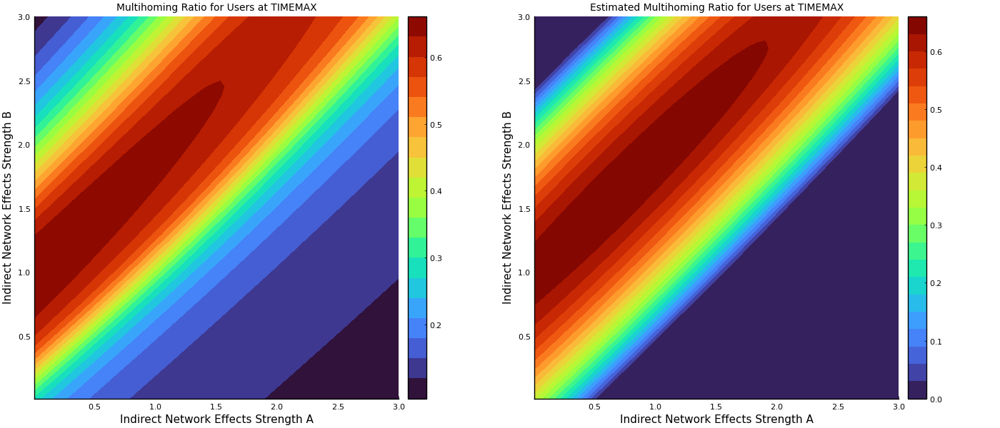

MSE: 0.008321176370086005
R^2: -0.7843432253288942

sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'
sys:1: UserWarning: The following kwargs were not used by contour: 'label'



AIC: 2.4220967129832065


In [50]:
using CSV, DataFrames
using Plots
using LaTeXStrings
using GLM, StatsBase
using Statistics

# Read the results from the CSV file
data = CSV.read("contourWiiPS3.csv", DataFrame)

# Define the values for the contour plot
xvals = data[:, :IndirectNetworkEffectsStrengthA]
yvals = data[:, :IndirectNetworkEffectsStrengthB]
zvals7 = data[:, :mhg_ratios_user_TMAX]


# Calculate model predictions for each row in the data
data[!, :model_predictions] = 0.36122988645383125 .+
                              -0.5258659368524684 .* data[!, :IndirectNetworkEffectsStrengthA] .+
                              0.5860822421528916 .* data[!, :IndirectNetworkEffectsStrengthB] .+
                              -0.2749577306917354 .* data[!, :IndirectNetworkEffectsStrengthA].^2 .+
                              -0.29993641918341807 .* data[!, :IndirectNetworkEffectsStrengthB].^2 .+
                              0.5585473534162707 .* data[!, :IndirectNetworkEffectsStrengthA] .* data[!, :IndirectNetworkEffectsStrengthB]

# If the model prediction is negative, set it to 0
data[!, :model_predictions] = max.(0.0, data[!, :model_predictions])

# Define the grid for x and y
gridA = sort(unique(xvals))
gridB = sort(unique(yvals))

# Pivot the data so it matches the grid
pivot_df = unstack(data, :IndirectNetworkEffectsStrengthB, :IndirectNetworkEffectsStrengthA, :model_predictions)

# Get the predictions in matrix form
predictions_matrix = Matrix(pivot_df[:, 2:end])

# Convert the results to a matrix format suitable for contour plot
xvals_mtrx = reshape(xvals, length(gridA), length(gridB))
yvals_mtrx = reshape(yvals, length(gridA), length(gridB))
zvals7_mtrx = reshape(zvals7, length(gridA), length(gridB))

# Create a plot with 2 subplots
p1 = contourf(xvals_mtrx, yvals_mtrx, zvals7_mtrx, title="Multihoming Ratio for Users at TIMEMAX", xlabel="Indirect Network Effects Strength A", ylabel="Indirect Network Effects Strength B", levels=21, color=:turbo, titlefontsize=10)

p2 = contourf(gridA, gridB, predictions_matrix, 
             title="Estimated Multihoming Ratio for Users at TIMEMAX", 
             xlabel="Indirect Network Effects Strength A", 
             ylabel="Indirect Network Effects Strength B", 
             levels=21, color=:turbo, 
             titlefontsize=10)

p = plot(p1, p2, layout = (1, 2), size = (1400, 600))

display(p)

# Extract real values and model predictions
real_values = data[:, :mhg_ratios_user_TMAX]
predicted_values = data[:, :model_predictions]

# Calculate Mean Squared Error
mse = sum((predicted_values .- real_values).^2) / length(real_values)

# Calculate R^2
SST = sum((real_values .- mean(real_values)).^2)
SSR = sum((predicted_values .- mean(real_values)).^2)
r2 = 1 - SSR / SST

println("MSE: ", mse)
println("R^2: ", r2)
# Define the model
function model_predictions(a, b)
  return 0.36122988645383125 .+
         -0.5258659368524684 .* a .+
         0.5860822421528916 .* b .+
         -0.2749577306917354 .* a.^2 .+
         -0.29993641918341807 .* b.^2 .+
         0.5585473534162707 .* a .* b
end

# Calculate model predictions for each row in the data
predicted_values = model_predictions(data[!, :IndirectNetworkEffectsStrengthA], data[!, :IndirectNetworkEffectsStrengthB])

# If the model prediction is negative, set it to 0
predicted_values = max.(0, predicted_values)

# Calculate residuals
residuals = data[:, :mhg_ratios_user_TMAX] .- predicted_values

# Calculate sum of squared residuals (SSE)
SSE_nonlinear = sum(residuals.^2)

# Calculate AIC
n = length(residuals) # number of data points
k = 6 # number of parameters in the model
AIC_nonlinear = 2*k + 2*log(SSE_nonlinear/n)

println("AIC: ", AIC_nonlinear)
